# Анализ рынка заведений общественного питания Москвы

## Введение

Данный проект состоит из двух частей:
- Анализ заведений Москвы;
- Анализ кофеен Москвы.

В ходе анализа всех заведений будет произведён анализ и формирование выводов по следующим пунктам:

1. Категории заведений;
2. Количество посадочных мест;
3. Соотношение сетевых и несетевых заведений;
4. Категории сетевых заведений;
5. Топ-15 сетевых заведений;
6. Заведения в разных административных округах;
7. Средние рейтинги категорий заведений;
8. Средние рейтинги заведений по административным округам;
9. Топ-15 популярных улиц по количеству заведений;
10. Улицы с одним заведением;
11. Средний чек в административных округах.

В ходе анализа кофеен будут рассмотрены:

1. Количество кофеен и их расположение;
2. Круглосуточные кофейни;
3. Рейтинги кофеен по административным округам;
4. Средняя стоимость чашки кофе в административных округах;

А также будут даны рекомендации по открытию новой кофейни.

**Презентация** https://drive.google.com/file/d/1bOzwDwP2h4ls34GqflZ9VXhAAMIeXJte/view?usp=share_link

## Предобработка данных

Импорт библиотек:

In [1]:
!pip install plotly==5.10.0
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots as ms
import folium
import json
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
import warnings
warnings.filterwarnings("ignore")

### Изучение информации о датасете

Откроем файл и рассмотрим общую информацию о данных:

In [2]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Файл содержит следующую информацию:
- **name** - название заведения;
- **category** - категория заведения;
- **address** - адрес заведения;
- **district** - административный район, в котором находится заведение;
- **hours** - информация о днях и часах работы;
- **lat** - широта географической точки, в которой находится заведение;
- **lng** - долгота географической точки, в которой находится заведение;
- **rating** - рейтинг заведения по оценкам пользователей в Яндекс Картах по пятибальной шкале;
- **price** - категория цен в заведении;
- **avg_bill** - строка, которая хранит среднюю стоимость заказа в виде диапазона;
- **middle_avg_bill** - число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»;
- **middle_coffee_cup** - число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»;
- **chain** - является ли заведение сетевым (0 - нет, 1 - да);
- **seats** - количество посадочных мест.

### Обработка пропусков и дубликатов

Проверим данные на наличие явных дубликатов:

In [4]:
df.duplicated().sum()

0

Явные дубликаты в таблице отсутствуют.

Посмотрим на пропуски данных в столбцах:

In [5]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

И рассчитаем процентное соотношение пропусков к общему количеству строк датафрейма:

In [6]:
round(df.isna().sum() * 100 / 8406, 3)

name                  0.000
category              0.000
address               0.000
district              0.000
hours                 6.376
lat                   0.000
lng                   0.000
rating                0.000
price                60.564
avg_bill             54.604
middle_avg_bill      62.539
middle_coffee_cup    93.635
chain                 0.000
seats                42.957
dtype: float64

Видим большое количество пропусков (от 42% до 94%) в следующих столбцах:
- категория цен в заведении;
- средняя стоимость заказа (диапазон);
- средний чек;
- средняя стоимость чашки капучино;
- количество посадочных мест.

На данном этапе удалять или заменять пропуски не будем. При удалении мы потеряем огромную часть данных, а возможных логичных вариантов для замены пропусков в указанных данных не представляется.

### Замена типов данных

Для удобства дальнейшей работы с данными произведём замену типов данных в двух столбцах: с информацией о том, является ли заведение сетевым, и в столбце с количеством посадочных мест.

In [7]:
df['chain'] = df['chain'].replace({1: 'сетевое', 0: 'несетевое'})
df['seats'] = df[np.logical_not(df['seats'].isnull())]['seats'].astype('int')

### Создание дополнительных столбцов

Далее создадим в таблице два новых столбца - столбец **street** с названиями улиц:

In [8]:
df['street'] = df['address'].str.split(', ').apply(lambda x: x[1])

И столбец **is_24/7**, отражающий, работает ли заведение ежедневно и круглосуточно (True - да, False - нет):

In [9]:
df['is_24/7'] = [0] * 8406
for i in range(0, len(df['hours']) - 1):
    if df['hours'][i] == 'ежедневно, круглосуточно':
        df['is_24/7'][i] = True
    else:
        df['is_24/7'][i] = False

## Анализ заведений Москвы

### Анализ категорий заведений

Рассмотрим, какие категории заведений представлены в нашем датасете и посмотрим распределение по ним:

In [10]:
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [11]:
categories = df.groupby('category', as_index = False)\
.agg({'name': 'count'})\
.sort_values(by = 'name', ascending = False)\
.rename(columns = {'name': 'amount'})

categories['percents'] = round(categories['amount'] * 100 / categories['amount'].sum(), 3)
categories

,category,amount,percents
3,кафе,2378,28.289
6,ресторан,2043,24.304
4,кофейня,1413,16.809
0,"бар,паб",765,9.101
5,пиццерия,633,7.530
2,быстрое питание,603,7.173
7,столовая,315,3.747
1,булочная,256,3.045


Визуализируем данные:

In [12]:
px.bar(categories, 
       'category', 
       'amount', 
       title = 'Количество заведений по категориям',
      labels = {'category': 'Категории заведений',
               'amount': 'Количество заведений'},
      text = 'amount')

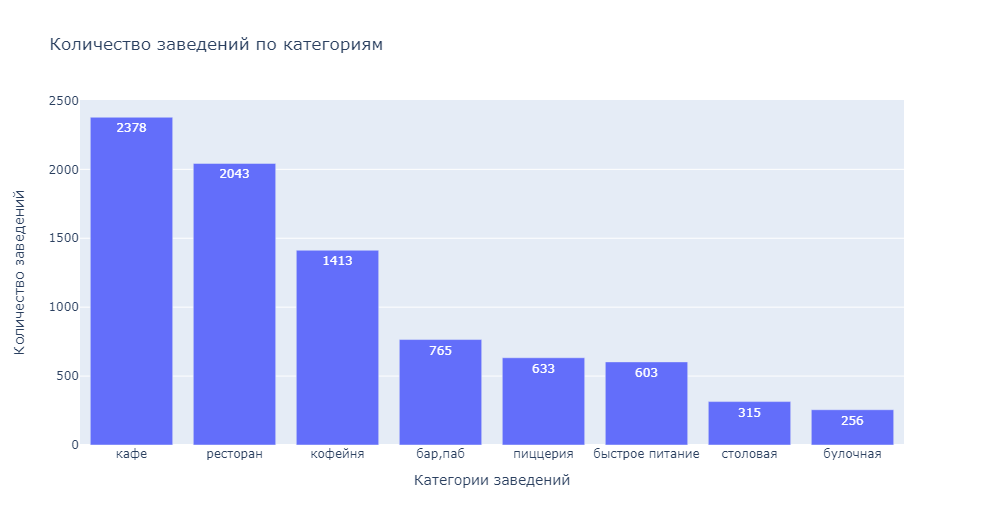

In [13]:
px.pie(categories,
      values = 'amount',
      names = 'category',
      title = 'Распределение долей заведений по категориям')

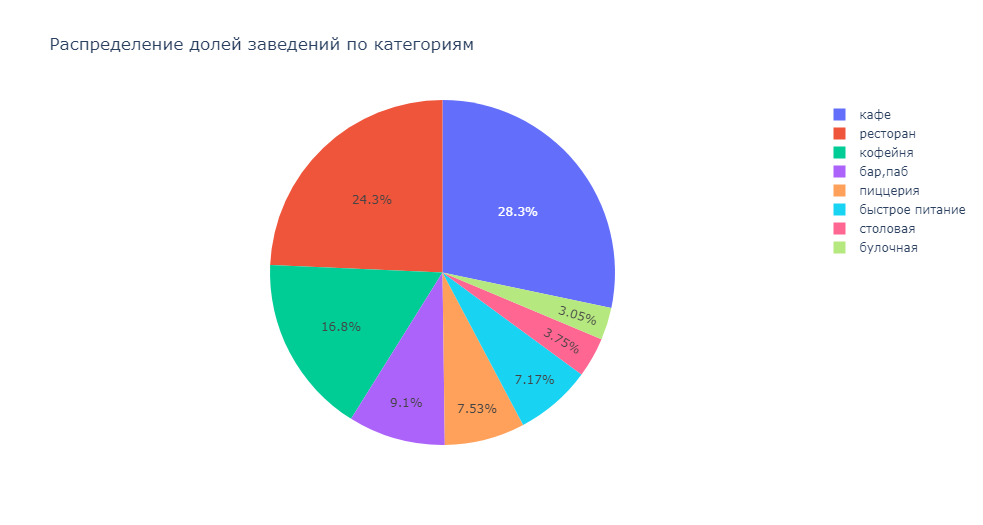

**Промежуточный вывод:**

Наибольшее количество заведений - в категориях **"кафе"** и **"ресторан"** (более 2000 заведений и более 24% от общего количества), а наименьшее - в категориях **"столовая"** и **"булочная"** (менее 400 заведений и менее 4% от общего количества). 

### Анализ количества посадочных мест по категориям заведений

Рассмотрим распределение количества посадочных мест по разным категориям заведений. Сначала посмотрим, какое количество уникальных значений у нас есть в столбце с количеством мест:

In [14]:
df['seats'].nunique()

229

In [15]:
sorted(df['seats'].unique())

[nan,
 0.0,
 1.0,
 2.0,
 3.0,
 4.0,
 5.0,
 6.0,
 7.0,
 8.0,
 9.0,
 10.0,
 12.0,
 13.0,
 14.0,
 15.0,
 16.0,
 17.0,
 18.0,
 19.0,
 20.0,
 21.0,
 22.0,
 24.0,
 25.0,
 26.0,
 27.0,
 28.0,
 29.0,
 30.0,
 32.0,
 33.0,
 34.0,
 35.0,
 36.0,
 37.0,
 38.0,
 39.0,
 40.0,
 41.0,
 42.0,
 43.0,
 44.0,
 45.0,
 46.0,
 47.0,
 48.0,
 49.0,
 50.0,
 51.0,
 52.0,
 53.0,
 54.0,
 55.0,
 56.0,
 58.0,
 60.0,
 61.0,
 62.0,
 63.0,
 64.0,
 65.0,
 66.0,
 67.0,
 68.0,
 69.0,
 70.0,
 72.0,
 74.0,
 75.0,
 76.0,
 77.0,
 78.0,
 79.0,
 80.0,
 81.0,
 82.0,
 83.0,
 84.0,
 85.0,
 86.0,
 87.0,
 88.0,
 90.0,
 92.0,
 93.0,
 94.0,
 95.0,
 96.0,
 97.0,
 98.0,
 99.0,
 100.0,
 102.0,
 104.0,
 105.0,
 106.0,
 107.0,
 108.0,
 110.0,
 112.0,
 113.0,
 114.0,
 115.0,
 116.0,
 118.0,
 120.0,
 122.0,
 124.0,
 125.0,
 126.0,
 127.0,
 128.0,
 130.0,
 131.0,
 132.0,
 133.0,
 135.0,
 138.0,
 140.0,
 141.0,
 143.0,
 144.0,
 145.0,
 146.0,
 147.0,
 148.0,
 150.0,
 151.0,
 154.0,
 155.0,
 157.0,
 158.0,
 159.0,
 160.0,
 161.0,
 164.0,
 165.0,

Количества мест варьируются от нуля (это могут быть кафе, работающие "навынос", или же ошибки сбора данных). В любом случае, разброс данных очень велик, поэтому разделим заведения на категории, применив для этого функцию pd.qcut:

In [16]:
df['seats_cat'] = pd.qcut(df['seats'], 5, labels = ['до 35 включительно', 
                                                    'от 36 до 54 включительно', 
                                                    'от 55 до 92 включительно', 
                                                    'от 93 до 160 включительно', 
                                                    'от 161'])

Рассчитаем количество заведений с распределением по категории заведения и количеству посадочных мест:

In [17]:
seats_cat = df.pivot_table(index = ['seats_cat', 'category'], 
                           values = 'name', 
                           aggfunc = 'count')\
.rename(columns = {'name': 'amount'})
seats_cat

amount
seats_cat                 category               
до 35 включительно        бар,паб              60
                          булочная             49
                          быстрое питание     100
                          кафе                305
                          кофейня             172
                          пиццерия            128
                          ресторан            167
                          столовая             32
от 36 до 54 включительно  бар,паб              91
                          булочная             31
                          быстрое питание      56
                          кафе                269
                          кофейня             125
                          пиццерия             85
                          ресторан            215
                          столовая             35
от 55 до 92 включительно  бар,паб             117
                          булочная             18
                          быстрое питание      56
                          кафе                235
                          кофейня             129
                          пиццерия             72
                          ресторан            292
                          столовая             38
от 93 до 160 включительно бар,паб             101
                          булочная             25
                          быстрое питание      70
                          кафе                213
                          кофейня             173
                          пиццерия             64
                          ресторан            305
                          столовая             39
от 161                    бар,паб              99
                          булочная             25
                          быстрое питание      67
                          кафе                196
                          кофейня             152
                          пиццерия             78
                          ресторан            291
                          столовая             20

И визуализируем данные:

In [18]:
seats_cat = seats_cat.reset_index()

In [19]:
px.histogram(seats_cat, 
             x = 'seats_cat', 
             y = 'amount', 
             color = 'category', 
             barmode = 'group',
            title = 'Количество заведений в разрезе количества посадочных мест',
            labels = {'seats_cat': 'Количество посадочных мест',
                     'category': 'Категория'},
            text_auto = True)

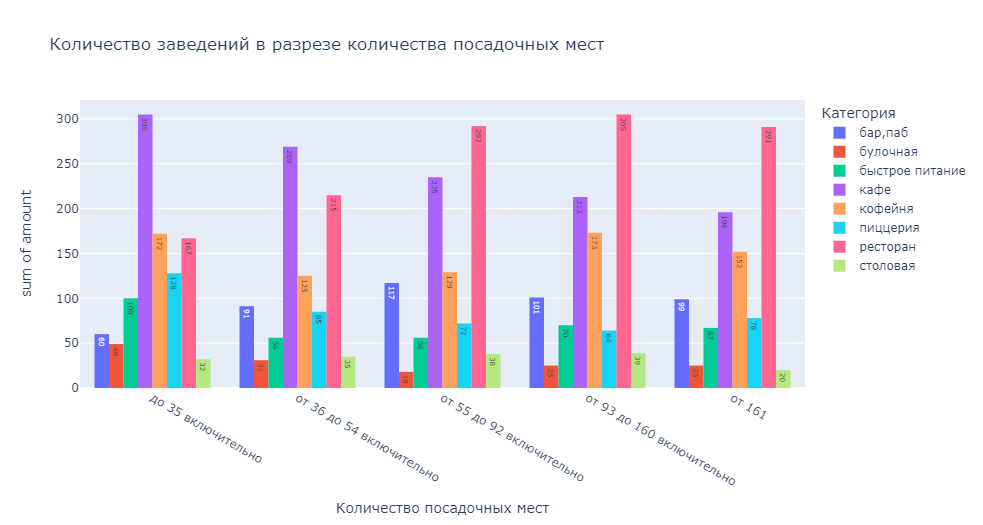

In [20]:
fig = ms(rows = 4, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'кафе']['amount'], 
                     name = 'кафе',
                    title = 'Кафе'),
              1, 1)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'ресторан']['amount'], 
                     name = 'ресторан',
                    title = 'Ресторан'),
              1, 2)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'кофейня']['amount'], 
                     name = 'кофейня',
                    title = 'Кофейня'),
              2, 1)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'бар,паб']['amount'], 
                     name = 'бар,паб',
                    title = 'Бар, паб'),
              2, 2)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'пиццерия']['amount'], 
                     name = 'пиццерия',
                    title = 'Пиццерия'),
              3, 1)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'быстрое питание']['amount'], 
                     name = 'быстрое питание',
                    title = 'Быстрое питание'),
              3, 2)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'столовая']['amount'], 
                     name = 'столовая',
                    title = 'Столовая'),
              4, 1)
fig.add_trace(go.Pie(labels = seats_cat['seats_cat'].unique(), 
                     values = seats_cat[seats_cat['category'] == 'булочная']['amount'], 
                     name = 'булочная',
                    title = 'Булочная'),
              4, 2)
fig.update_layout(autosize = False,
                  width=1000,
                  height=1000,
                 title = 'Распределение долей количества посадочных мест в разрезе категорий заведений')

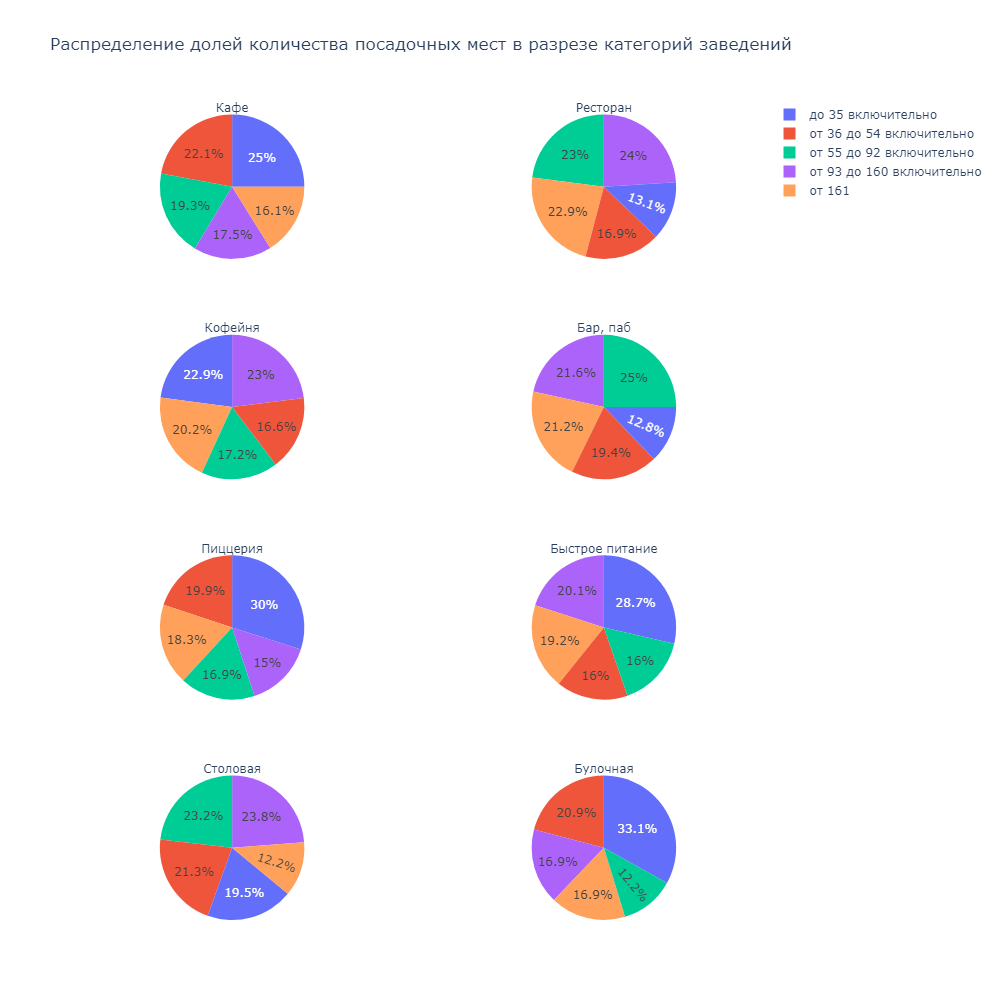

**Промежуточный вывод**:

- среди заведений с количеством посадочных мест до 54 преобладают кофейни, а свыше 54 - рестораны;
- наименьшие доли во всех категориях количества посадочных мест отводятся столовым и булочным;
- в категориях "кафе", "пиццерия", "быстрое питание" и "булочная" преобладают заведения до 35 посадочных мест;
- в ресторанах, кофейнях и столовых наибольшая доля заведений с количеством посадочных мест от 93 до 160 включительно;
- в барах и пабах чаще всего от 55 до 92 посадочных мест.

### Анализ соотношения сетевых и несетевых заведений

Сгруппируем заведения по столбцу chain и посчитаем их количество:

In [21]:
chain = df.groupby('chain', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

chain['percent'] = round(chain['amount'] * 100 / chain['amount'].sum(), 3)
chain

,chain,amount,percent
0,несетевое,5201,61.872
1,сетевое,3205,38.128


И отразим полученные данные на графике:

In [22]:
px.pie(chain,
      values = 'amount',
      names = 'chain',
      title = 'Соотношение сетевых и несетевых заведений')

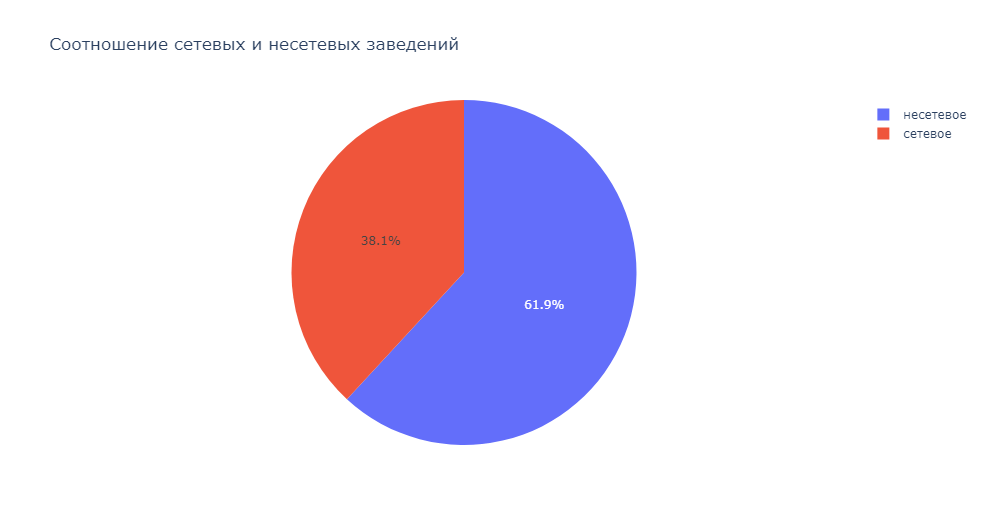

**Промежуточный вывод**:

Несмотря на то, что мы подсчитали общее количество заведений, а не только уникальные названия, несетевых заведений всё же оказалось почти в 1,5 раза больше, чем сетевых (61,9% против 38,1%).

### Анализ категорий сетевых заведений

Проверим, какие категории заведений чаще являются сетевыми. Сгруппируем заведения по категориям и признаку сетевых/несетевых:

In [23]:
chain_2 = df.groupby(['category', 'chain'], as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

chain_2

,category,chain,amount
0,"бар,паб",несетевое,596
1,"бар,паб",сетевое,169
2,булочная,несетевое,99
3,булочная,сетевое,157
4,быстрое питание,несетевое,371
5,быстрое питание,сетевое,232
6,кафе,несетевое,1599
7,кафе,сетевое,779
8,кофейня,несетевое,693
9,кофейня,сетевое,720


In [24]:
px.histogram(chain_2,
            x = 'category',
            y = 'amount',
            color = 'chain',
            barmode = 'group',
            title = 'Количество сетевых и несетевых заведений по категориям',
            labels = {'category': 'Категория',
                     'chain': ''},
            text_auto = True)

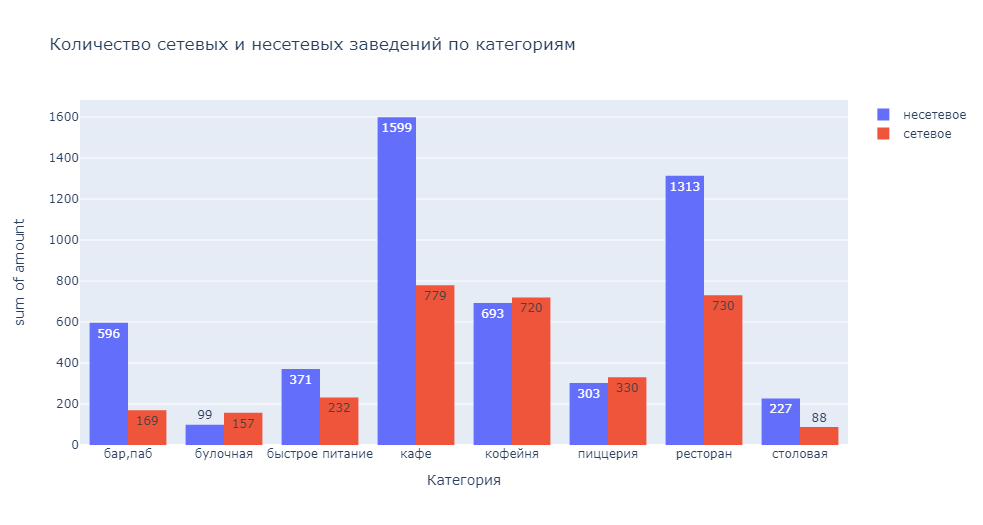

In [25]:
fig = ms(rows = 4, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}],
                                                [{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'кафе']['amount'], 
                     name = 'кафе',
                    title = 'Кафе'),
              1, 1)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'ресторан']['amount'], 
                     name = 'ресторан',
                    title = 'Ресторан'),
              1, 2)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'кофейня']['amount'], 
                     name = 'кофейня',
                    title = 'Кофейня'),
              2, 1)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'бар,паб']['amount'], 
                     name = 'бар,паб',
                    title = 'Бар, паб'),
              2, 2)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'пиццерия']['amount'], 
                     name = 'пиццерия',
                    title = 'Пиццерия'),
              3, 1)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'быстрое питание']['amount'], 
                     name = 'быстрое питание',
                    title = 'Быстрое питание'),
              3, 2)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'столовая']['amount'], 
                     name = 'столовая',
                    title = 'столовая'),
              4, 1)
fig.add_trace(go.Pie(labels = chain_2['chain'].unique(), 
                     values = chain_2[chain_2['category'] == 'булочная']['amount'], 
                     name = 'булочная',
                    title = 'булочная'),
              4, 2)
fig.update_layout(autosize = False,
                  width=1000,
                  height=1000,
                 title = 'Распределение долей сетевых и несетевых заведений по категориям')

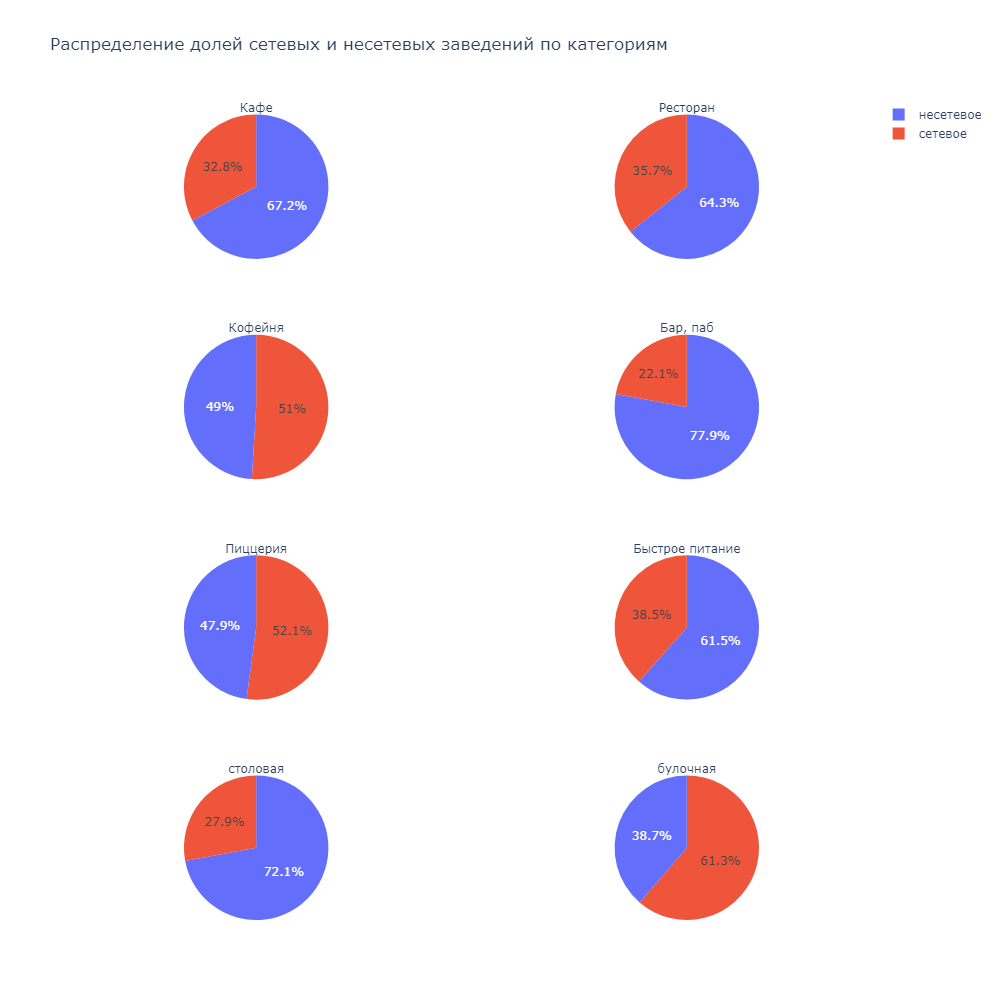

**Промежуточный вывод**:

- из первого графика видно, что наибольшее количество среди сетевых заведений составляют кафе, кофейни и рестораны;
- при этом в целом рестораны и кафе - чаще всего несетевые (64,3% против 35,7% для ресторанов и 67,2% против 32,8% для кафе);
- почти в каждой категории превалируют несетевые заведения, за исключением кофеен, пиццерий и булочных.

### Анализ топ-15 сетевых заведений

Сгруппируем заведения по названию и выберем топ-15 сетевых заведений по их количеству:

In [26]:
chain_top = df.groupby('name', as_index = False)\
.agg({'chain': 'count'})\
.rename(columns = {'chain': 'amount'})\
.sort_values(by = 'amount', ascending = False)\

chain_top.head(20)

,name,amount
2890,Кафе,189
5522,Шоколадница,120
2584,Домино'с Пицца,76
2551,Додо Пицца,74
1156,One Price Coffee,71
5595,Яндекс Лавка,69
419,Cofix,65
1290,Prime,50
5083,Хинкальная,44
5421,Шаурма,43


Исключим из перечня заведения, которые с большой вероятностью не являются сетевыми, а просто распространёнными названиями: "Кафе", "Хинкальная", "Шаурма", "Чайхана", "Ресторан", "Столовая".

Финальный список заведений будет выглядеть следующим образом:

In [27]:
chain_top = chain_top[np.logical_not(chain_top['name']
                                     .isin(['Кафе', 'Хинкальная', 'Шаурма', 'Чайхана', 'Ресторан', 'Столовая']))]\
.head(15)

chain_top

,name,amount
5522,Шоколадница,120
2584,Домино'с Пицца,76
2551,Додо Пицца,74
1156,One Price Coffee,71
5595,Яндекс Лавка,69
419,Cofix,65
1290,Prime,50
2825,КОФЕПОРТ,42
3302,Кулинарная лавка братьев Караваевых,39
4788,Теремок,38


Отразим данные на графике:

In [28]:
px.bar(chain_top.sort_values(by = 'amount', ascending = True),
      x = 'amount',
      y = 'name',
      title = 'Количество заведений в топ-15 сетях',
      text_auto = True,
      labels = {'amount': 'Количество заведений',
               'name': ''})

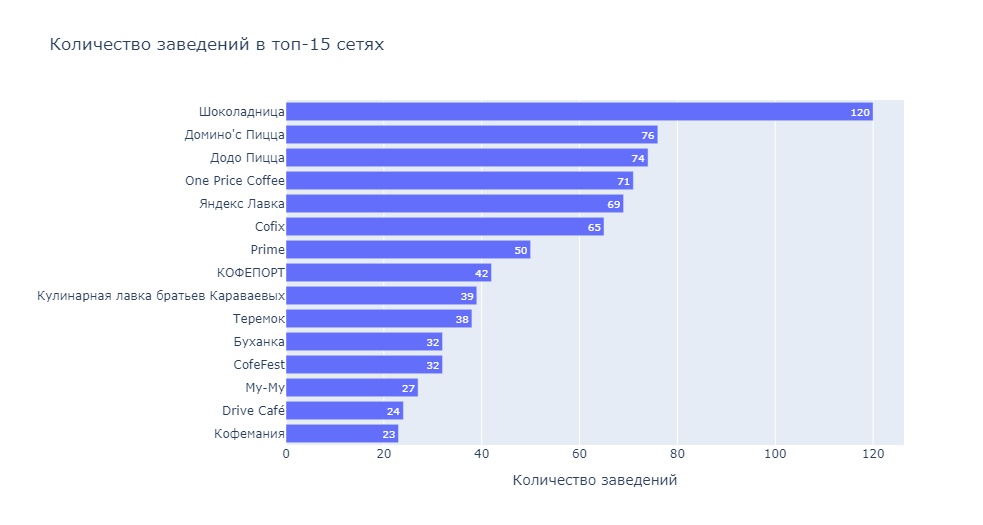

А также рассмотрим на графике распределение сетевых заведений из топ-15 по районам:

In [29]:
px.histogram(df[df['name'].isin(chain_top['name'])],
             x = 'district',
             color = 'name',
            labels = {'district': 'Район',
                     'name': 'Название сети'},
            title = 'Количество заведений из топ-15 сетей по районам')\
.update_layout(xaxis = {'categoryorder': 'total descending'},
              yaxis = dict(title = 'Количество заведений'))

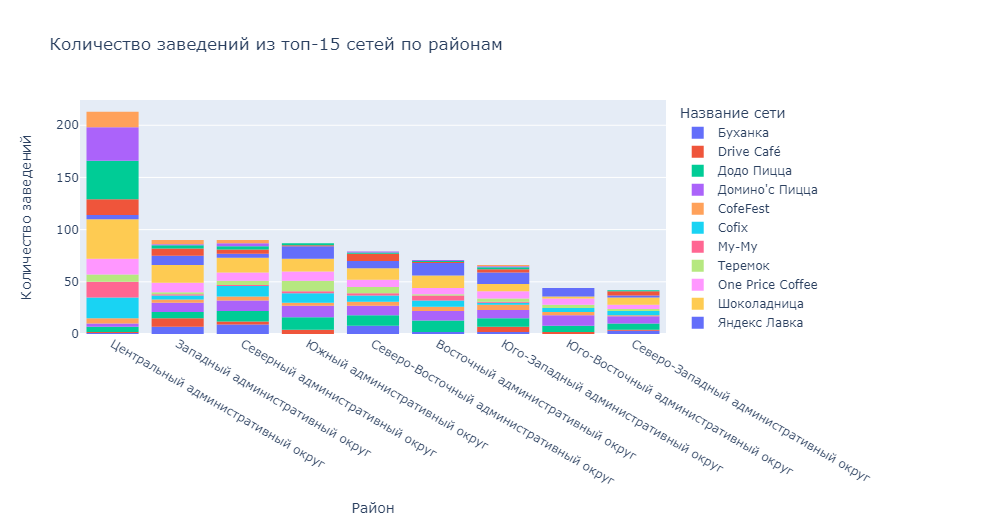

Посмотрим, заведений какого формата больше всего в топ-15 сетях:

In [30]:
chain_rates = df[df['name'].isin(chain_top['name'])].pivot_table(index = 'category', values = 'name', aggfunc = 'count')\
.reset_index()\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)

chain_rates['percent'] = round(chain_rates['amount'] * 100 / chain_rates['amount'].sum(), 3)
chain_rates

,category,amount,percent
4,кофейня,358,45.780
6,ресторан,163,20.844
5,пиццерия,151,19.309
3,кафе,79,10.102
1,булочная,25,3.197
2,быстрое питание,4,0.512
0,"бар,паб",1,0.128
7,столовая,1,0.128


In [31]:
px.pie(chain_rates,
      names = 'category',
      values = 'amount',
      title = 'Распределение категорий сетевых заведений в топ-15 сетей')

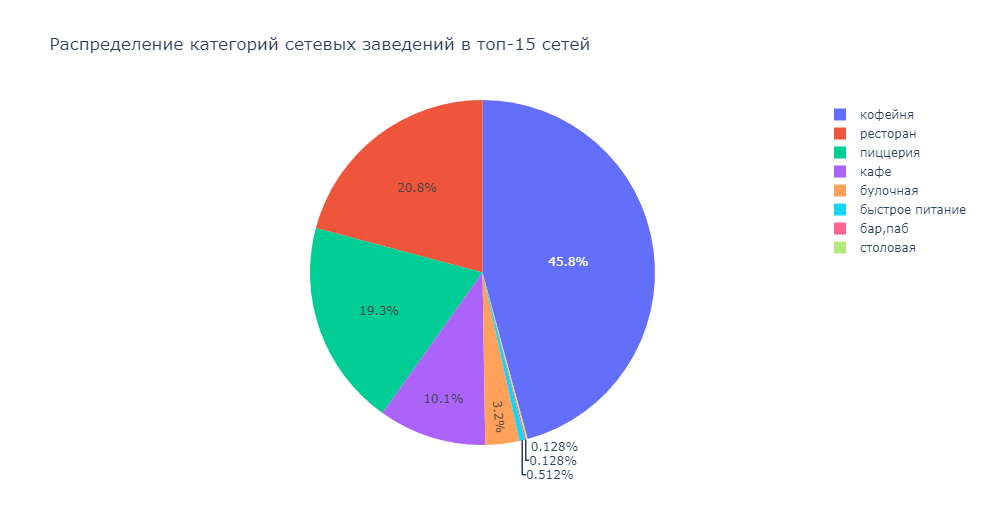

**Промежуточный вывод**:

- в топ-15 сетевых заведений ожидаемо попали заведения "на слуху" - такие, как "Шоколадница", "Додо пицца", "Доминос пицца" и др.;
- наибольшее количество заведений из топ-15 находятся в Центральном районе, наименьшее же - в Северо-Западном административном округе;
- наибольшую долю в топ-15 сетях составляет категория "кофейни" - это почти половина от общего количества заведений в топ-15, за ними следуют рестораны и пиццерии, совместно составляя около 40%;
- наименьшее количество в топ-15 сетевых заведений составляют заведения быстрого питания, бары, пабы и столовые - в сумме менее 1% от общего количества заведений топа.

### Анализ заведений по районам

Рассмотрим, какие административные округи представлены в датасете:

In [32]:
sorted(df['district'].unique())

['Восточный административный округ',
 'Западный административный округ',
 'Северный административный округ',
 'Северо-Восточный административный округ',
 'Северо-Западный административный округ',
 'Центральный административный округ',
 'Юго-Восточный административный округ',
 'Юго-Западный административный округ',
 'Южный административный округ']

Визуализируем количество заведений каждой категории по районам:

In [33]:
px.histogram(df,
            x = 'district',
            color = 'category',
            title = 'Количество заведений по категориям в разрезе районов',
            labels = {'district': 'Район',
                     'category': 'Категория'})\
.update_layout(xaxis = {'categoryorder': 'total descending'},
              yaxis = dict(title = 'Количество заведений'))

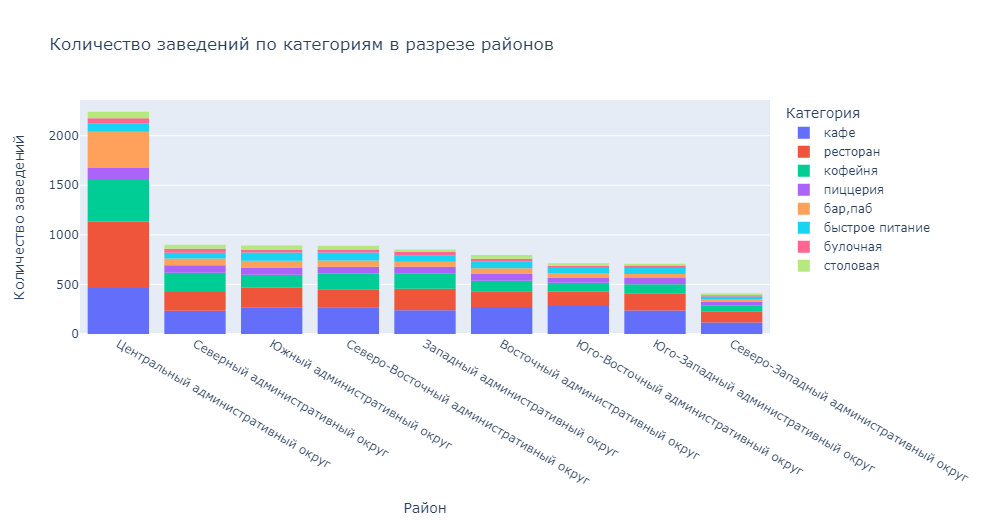

**Промежуточный вывод**:

- наибольшее количество заведений - в Центральном административном округе, наименьшее - в Северо-Западном;
- в Центральном округе также значительно больше абсолютное количество заведений каждой категории, за исключением категории "быстрое питание".

### Анализ средних рейтингов по категориям заведений

Рассчитаем средние рейтинги по категориям заведений и визуализируем их:

In [34]:
avg_rating = df.groupby('category', as_index = False)\
.agg({'rating': 'mean'})\
.sort_values(by = 'rating', ascending = False)

avg_rating['rating'] = round(avg_rating['rating'], 2)
avg_rating

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


In [35]:
px.bar(avg_rating,
       x = 'category',
       y = 'rating',
      title = 'Средний рейтинг по категориям заведений',
      labels = {'category': 'Категория',
               'rating': 'Средний рейтинг'},
      text_auto = True)\
.update_yaxes(range = list([4, 4.5]))

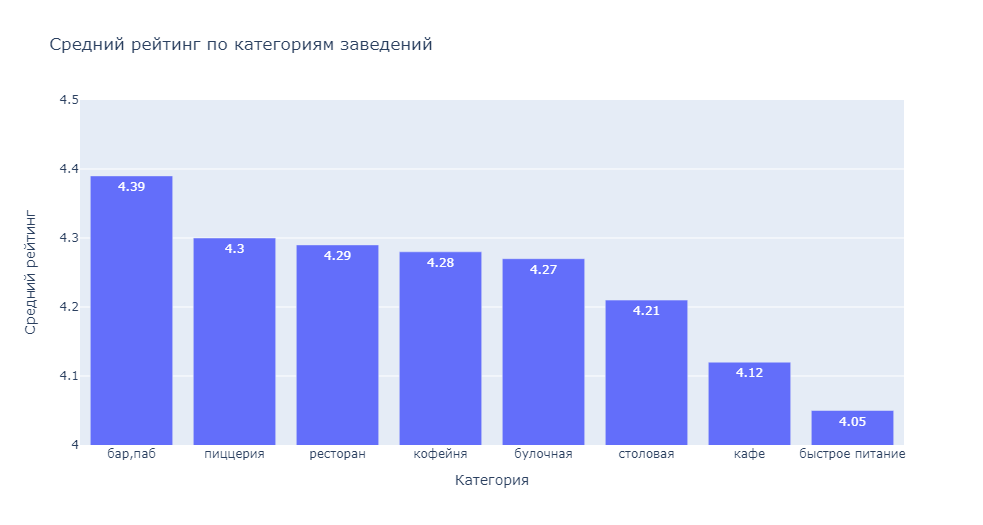

**Промежуточный вывод**:

Средний рейтинг не сильно разнится в зависимости от категорий заведений, для каждой категории он выше 4 пунктов. Однако при этом самый высокий рейтинг - у баров и пабов (4,39), а самый низкий - у кафе и заведений быстрого питания (4,12 и 4,05 соответственно).

### Картограмма средних рейтингов заведений по регионам

Рассчитаем средний рейтинг заведений в разрезе районов:

In [36]:
avg_rating_by_district = df.groupby('district', as_index = False)\
.agg({'rating': 'mean'})\
.sort_values(by = 'rating', ascending = False)

avg_rating_by_district['rating'] = round(avg_rating_by_district['rating'], 2)
avg_rating_by_district

,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
8,Южный административный округ,4.18
1,Западный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


In [37]:
px.bar(avg_rating_by_district,
      x = 'district',
      y = 'rating',
      title = 'Средний рейтинг по административным округам',
      labels = {'district': 'Район',
               'rating': 'Рейтинг'},
      text_auto = True)\
.update_yaxes(range = list([4, 4.5]))

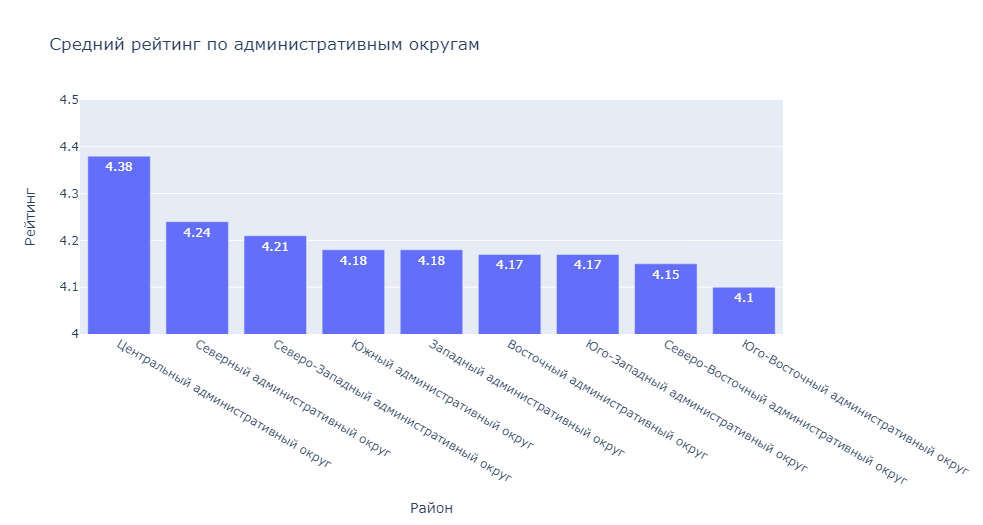

Далее сохраним json-файл с координатами границ областей округов в переменную:

И создадим фоновую картограмму Москвы с нанесёнными на неё границами округов:

In [39]:
moscow_map_states = Map(location = [55.751244, 37.618423],
                        zoom_start=10)

Choropleth(geo_data = state_geo,
          data = avg_rating_by_district,
          columns = ['district', 'rating'],
          key_on = 'feature.name',
          fill_color = 'Blues',
          fill_opacity = 0.8,
          legend_name = 'Средний рейтинг заведений по районам').add_to(moscow_map_states)

moscow_map_states

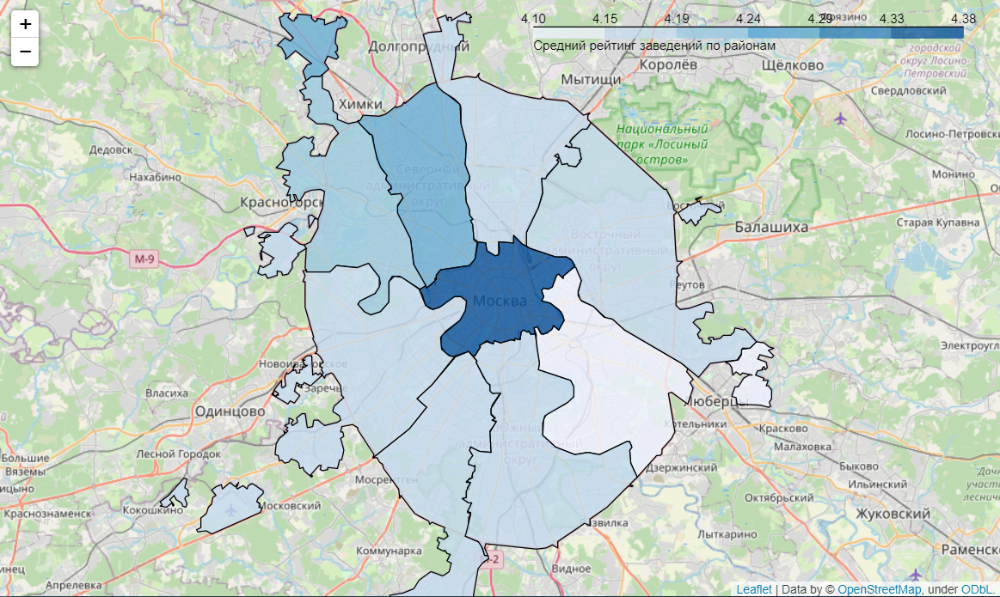

**Промежуточный вывод**:

Карта наглядно показала расчёты среднего чека: самый высокий средний рейтинг - в Центральном административном округе (4,38), а самый низкий - в Юго-Восточном (4,1).

### Отображение заведений на карте

Создадим новую "чистую" карту (без нанесения на неё заливки округов по средним чекам), а также пустой кластер для маркеров заведений:

In [40]:
moscow_map = Map(location = [55.751244, 37.618423],
                zoom_start = 10)
cluster = MarkerCluster().add_to(moscow_map)

Зададим функцию, которая принимает в качестве аргумента **строку таблицы**, а в результате добавляет маркер на карту:

In [41]:
def create_cluster(row):
    Marker([row['lat'], row['lng']],
          popup = f"{row['name']} {row['rating']}").add_to(cluster)

Применим функцию к строкам таблицы df и отобразим карту:

In [42]:
df.apply(create_cluster, axis = 1)
moscow_map

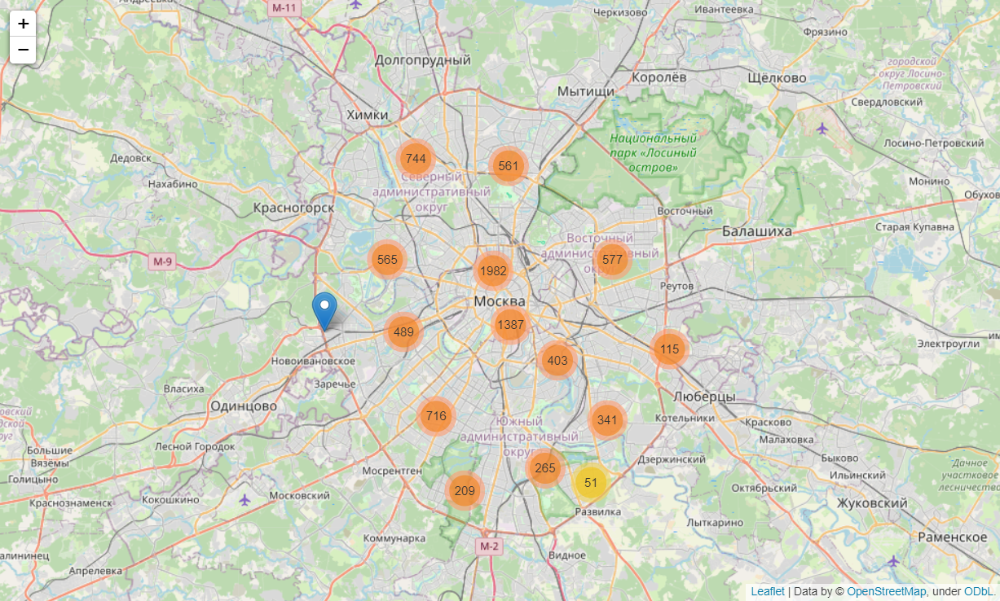

### Анализ топ-15 улиц по количеству заведений:

Сгруппируем таблицу по названию улиц:

In [43]:
street_top = df.groupby('street', as_index = False)[['street', 'category', 'name']].\
agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)\
.head(15)

street_top

,street,amount
1090,проспект Мира,184
773,Профсоюзная улица,122
1087,проспект Вернадского,108
525,Ленинский проспект,107
523,Ленинградский проспект,95
373,Дмитровское шоссе,88
455,Каширское шоссе,77
298,Варшавское шоссе,76
524,Ленинградское шоссе,70
550,МКАД,65


Визуализируем данные о количестве заведений на графике:

In [44]:
px.histogram(df[df['street'].isin(street_top['street'])],
            x = 'street',
            color = 'category',
            title = 'Количество заведений по категориям в разрезе топ-15 улиц',
            labels = {'category': 'Категория',
                     'street': 'Улица'})\
.update_layout(xaxis = {'categoryorder': 'total descending'},
              yaxis = dict(title = 'Количество заведений'))

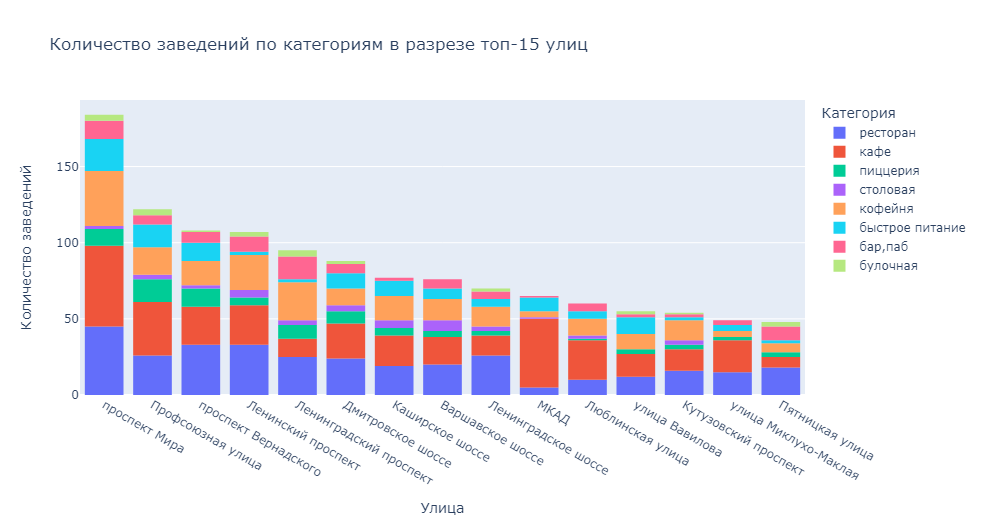

**Промежуточный вывод**:

- наибольшее количество заведений среди топ-15 улиц - на проспекте Мира, а наименьшее - на Пятницкой улице;
- на проспекте Мира также большее абослютное количество ресторанов, кафе, кофеен и заведений быстрого питания, но по абсолютному количеству заведений других категорий проспект Мира проигрывает другим улицам.

### Анализ улиц с одним заведением общепита

Найдём улицы, на которых расположено только одно заведение, и посмотрим, что это за заведения:

In [45]:
street_one = df.groupby('street', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

single_on_street = df[df['street'].isin(street_one[street_one['amount'] == 1]['street'])]
single_on_street.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,seats_cat
15,Дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,несетевое,180.0,улица Бусиновская Горка,False,от 161
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,несетевое,NaN,Прибрежный проезд,False,NaN
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,сетевое,NaN,парк Левобережный,False,NaN
58,Coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,сетевое,NaN,Угличская улица,False,NaN
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,сетевое,NaN,ландшафтный заказник Лианозовский,False,NaN


Рассмотрим, к каким категориям относятся эти заведения:

In [46]:
single_on_street['category'].unique()

array(['столовая', 'кафе', 'кофейня', 'ресторан', 'бар,паб',
       'быстрое питание', 'пиццерия', 'булочная'], dtype=object)

Среди таких заведений встречаются заведения всех восьми категорий.

Проверим, в каких районах можно встретить такие заведения:

In [47]:
single_on_street['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Западный административный округ',
       'Юго-Восточный административный округ',
       'Юго-Западный административный округ',
       'Южный административный округ'], dtype=object)

Такие заведения встречаются также и во всех 9 административных округах.

Посмотрим на средний рейтинг таких заведений с разделением по категориям:

In [48]:
single_by_cat = single_on_street.groupby('category', as_index = False)\
.agg({'rating': 'mean'})\
.sort_values(by = 'rating', ascending = False)

single_by_cat['rating'] = round(single_by_cat['rating'], 2)
single_by_cat

,category,rating
0,"бар,паб",4.48
5,пиццерия,4.37
1,булочная,4.34
4,кофейня,4.31
7,столовая,4.26
6,ресторан,4.25
3,кафе,4.13
2,быстрое питание,4.08


И сравним его со средним рейтингом заведений по категориям в целом:

In [49]:
go.Figure().add_trace(go.Bar(x = single_by_cat['category'],
                            y = single_by_cat['rating'],
                            name = 'Единственное заведение на улице',
                            marker_color = 'blue',
                            text = single_by_cat['rating']))\
.add_trace(go.Bar(x = avg_rating['category'],
                 y = avg_rating['rating'],
                 name = 'Все заведения',
                 marker_color = 'slateblue',
                 text = avg_rating['rating']))\
.update_layout(title = 'Средний рейтинг по категориям заведений')\
.update_yaxes(range = list([4, 4.5]))

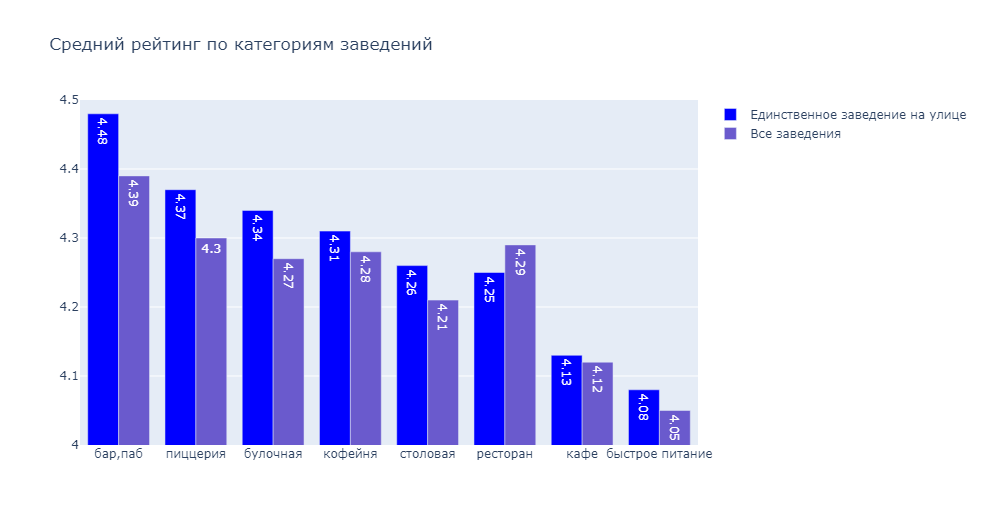

**Промежуточный вывод**:

Средний рейтинг для заведений, которые являются единственными на улице - немного, но выше, чем в целом по заведениям, за исключением ресторанов. Возможно, это связано с тем, что жители соседних домов чаще всего ходят именно в эти заведения (в силу близкого расположения) и им не с чем сравнивать такие заведения, отсюда возможна некоторая необъективность выставляемой оценки. Рестораны же для посещения наоборот, как правило, выбирают исходя из оценки места, а не из фактора близости к дому, поскольку поход в ресторан для большинства является несколько более значимым событием.

Проверим, заведения какой ценовой категории превалируют среди единственных на улице, и сравним полученные данные с результатом по заведениям в целом:

In [50]:
single_by_price = single_on_street.groupby('price', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)

single_by_price

,price,amount
3,средние,120
1,выше среднего,29
0,высокие,22
2,низкие,11


In [51]:
total_by_price = df.groupby('price', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)

total_by_price

,price,amount
3,средние,2117
1,выше среднего,564
0,высокие,478
2,низкие,156


In [52]:
ms(rows = 1, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}]])\
.add_trace(go.Pie(labels = single_by_price['price'], 
                  values = single_by_price['amount'],
                  name = 'Единственные заведения на улице',
                  title = 'Единственные заведения на улице'),
           1, 1)\
.add_trace(go.Pie(labels = total_by_price['price'], 
                  values = total_by_price['amount'], 
                  name = 'Все заведения',
                  title = 'Все заведения'),
           1, 2)\
.update_layout(title = 'Распределение долей заведений по категориям цен')

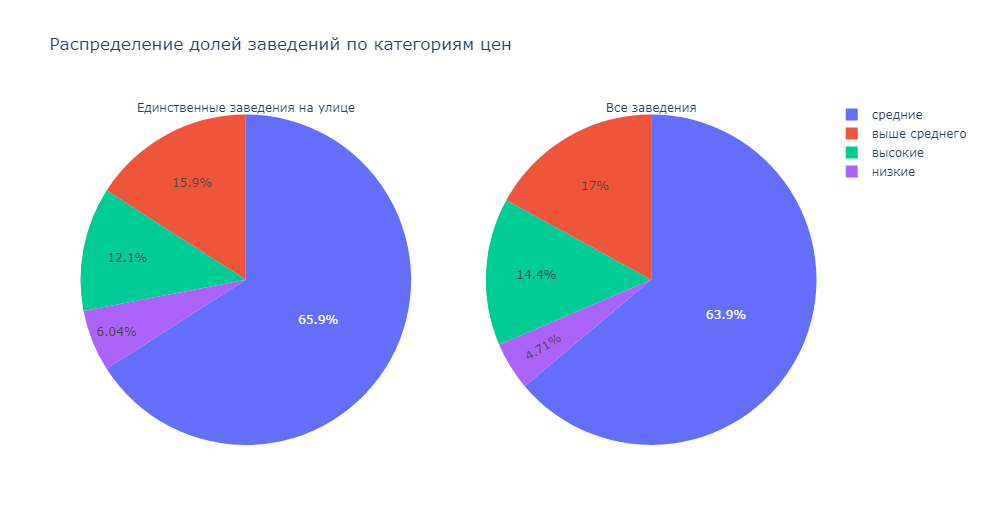

**Промежуточный вывод**:

Несмотря на то, ценовые категории по долям от большей к меньшей располагаются для всех заведений одинаково, само распределение долей показывает - среди единственных заведений на улице большее процентное соотношение заведений низкой и средней ценовой категории, чем для заведений в целом (более 71% против примерно 68%).

Посмотрим, встречаются ли среди таких заведений сетевые, и если да, то каково их соотношение к несетевым:

In [53]:
single_chain = single_on_street.groupby('chain', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

single_chain

,chain,amount
0,несетевое,325
1,сетевое,133


Соотношение визуализируем сразу в сравнении с соотношением среди всех заведений:

In [54]:
ms(rows = 1, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}]])\
.add_trace(go.Pie(labels = single_chain['chain'],
                 values = single_chain['amount'],
                 name = 'Единственные заведения на улице',
                 title = 'Единственные заведения на улице'),
          1, 1)\
.add_trace(go.Pie(labels = chain['chain'],
                  values = chain['amount'],
                  name = 'Все заведения',
                  title = 'Все заведения'),
          1, 2)\
.update_layout(title = 'Распределение сетевых и несетевых заведений')

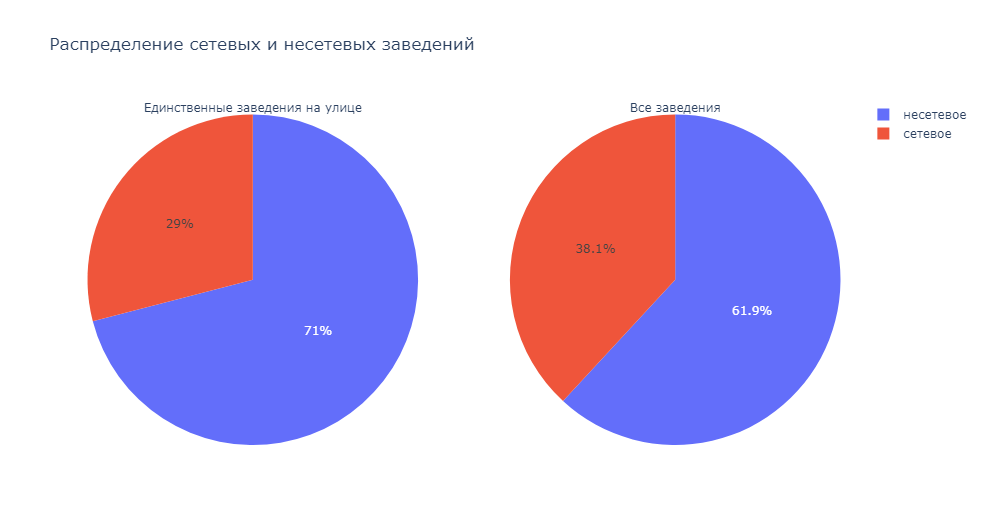

**Промежуточный вывод**:

В целом несетевых заведений больше в обоих случаях, но среди единственных заведений на улице их доля ожидаемо выше (71% против 61,9%).

Рассмотрим также соотношение круглосуточных и не круглосуточных заведений для единственных на улице в сравнении с заведениями в целом:

In [55]:
single_and_all_day = single_on_street.groupby('is_24/7', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\

single_and_all_day['is_24/7'] = single_and_all_day['is_24/7']\
.astype('str').replace('True', 'круглосуточные')\
.replace('False', 'не круглосуточные')

single_and_all_day

,is_24/7,amount
0,не круглосуточные,427
1,круглосуточные,31


In [56]:
all_day = df.groupby('is_24/7', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

all_day['is_24/7'] = all_day['is_24/7']\
.astype('str').replace('True', 'круглосуточные')\
.replace('False', 'не круглосуточные')

all_day

,is_24/7,amount
0,не круглосуточные,7677
1,круглосуточные,729


In [57]:
ms(rows = 1, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}]])\
.add_trace(go.Pie(labels = single_and_all_day['is_24/7'],
                 values = single_and_all_day['amount'],
                 name = 'Единственные заведения на улице',
                 title = 'Единственные заведения на улице'),
          1, 1)\
.add_trace(go.Pie(labels = all_day['is_24/7'],
                  values = all_day['amount'],
                  name = 'Все заведения',
                  title = 'Все заведения'),
          1, 2)\
.update_layout(title = 'Распределение круглосуточных и не круглосуточных заведений')

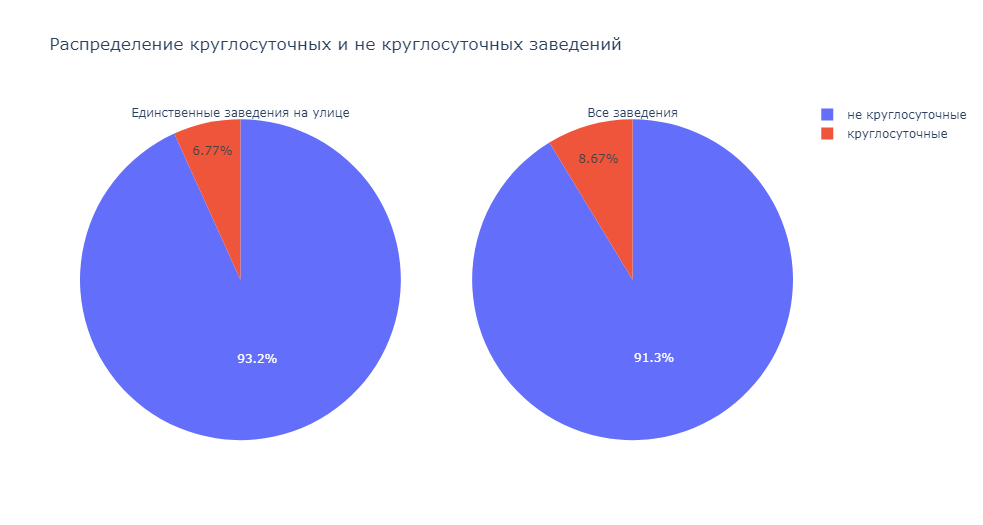

**Промежуточный вывод**:
    
Не круглосуточных заведений больше в обоих случаях, но их доля среди единственных заведений на улице больше, чем среди всех заведений (93,2% против 91,3%).

Проверим заведения на количество посадочных мест в сравнении:

In [58]:
single_seats = single_on_street.groupby('seats_cat', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

single_seats

,seats_cat,amount
0,до 35 включительно,50
1,от 36 до 54 включительно,49
2,от 55 до 92 включительно,29
3,от 93 до 160 включительно,20
4,от 161,8


In [59]:
all_seats = df.groupby('seats_cat', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

all_seats

,seats_cat,amount
0,до 35 включительно,1013
1,от 36 до 54 включительно,907
2,от 55 до 92 включительно,957
3,от 93 до 160 включительно,990
4,от 161,928


In [60]:
ms(rows = 1, cols = 2, specs = [[{'type':'domain'}, {'type':'domain'}]])\
.add_trace(go.Pie(labels = single_seats['seats_cat'],
                 values = single_seats['amount'],
                 name = 'Единственные заведения на улице',
                 title = 'Единственные заведения на улице'),
          1, 1)\
.add_trace(go.Pie(labels = all_seats['seats_cat'],
                  values = all_seats['amount'],
                  name = 'Все заведения',
                  title = 'Все заведения'),
          1, 2)\
.update_layout(title = 'Распределение заведений по категориям посадочных мест')

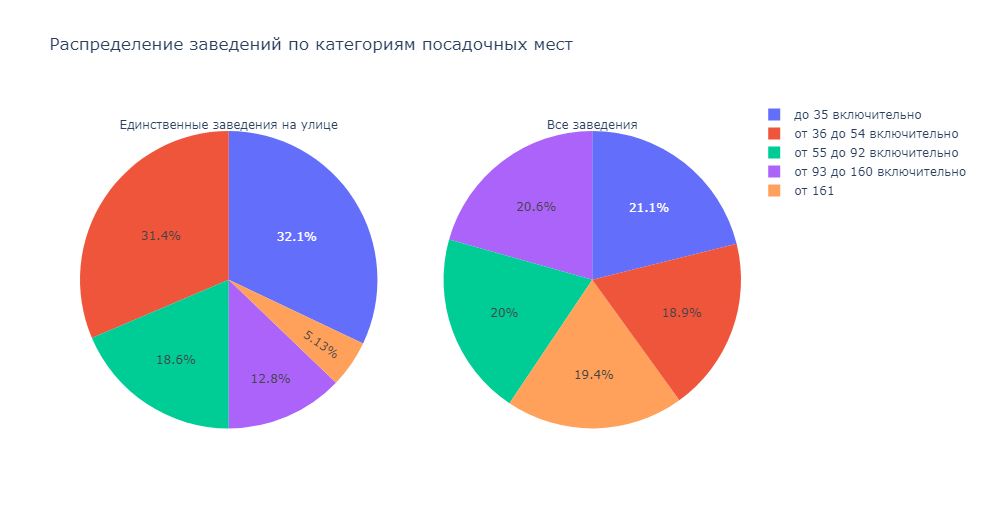

**Промежуточный вывод**:

Среди единственных заведений более 63% имеют до 54 посадочных мест, тогда как среди всех заведений - всего около 40% таких. При этом единственных на улице заведений с количеством посадочных мест более 160 - всего 5,13%, а в целом таких заведений почти в 4 раза больше - 19,4%.

### Анализ среднего чека в разрезе районов

Рассчитаем медианное значение среднего чека для каждого из районов:

In [61]:
avg_bill_by_district = df.groupby('district', as_index = False)\
.agg({'middle_avg_bill': 'median'})\
.rename(columns = {'middle_avg_bill': 'avg_bill'})\
.sort_values(by = 'avg_bill', ascending = False)

avg_bill_by_district

,district,avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [62]:
px.bar(avg_bill_by_district,
      x = 'district',
      y = 'avg_bill',
      title = 'Средний чек в административных округах',
      labels = {'district': 'Район',
                'avg_bill': 'Средний чек'},
      text_auto = True)

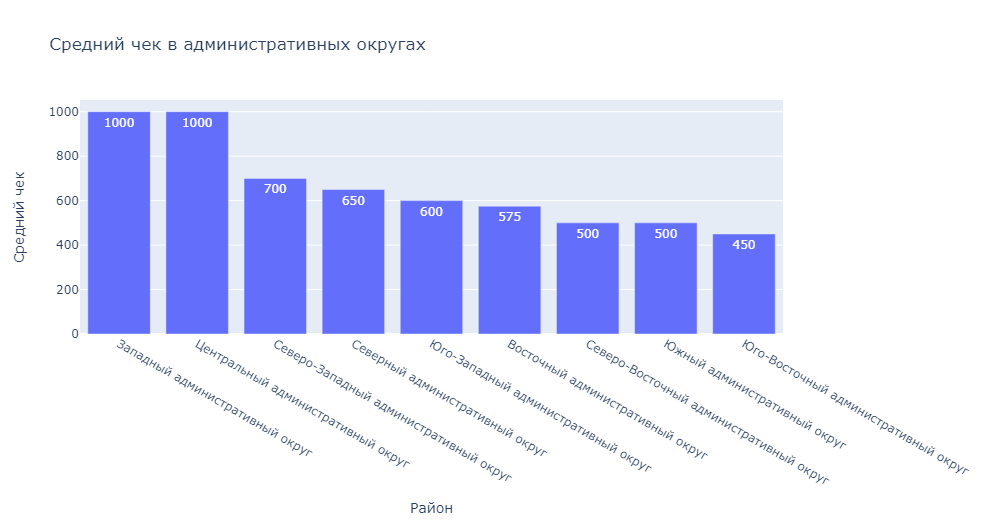

И нанесём значения на карту:

In [63]:
moscow_map_bill = Map(location = [55.751244, 37.618423],
                      zoom_start=10)

Choropleth(geo_data = state_geo,
          data = avg_bill_by_district,
          columns = ['district', 'avg_bill'],
          key_on = 'feature.name',
          fill_color = 'Blues',
          fill_opacity = 0.8,
          legend_name = 'Средний чек заведений по районам').add_to(moscow_map_bill)

moscow_map_bill

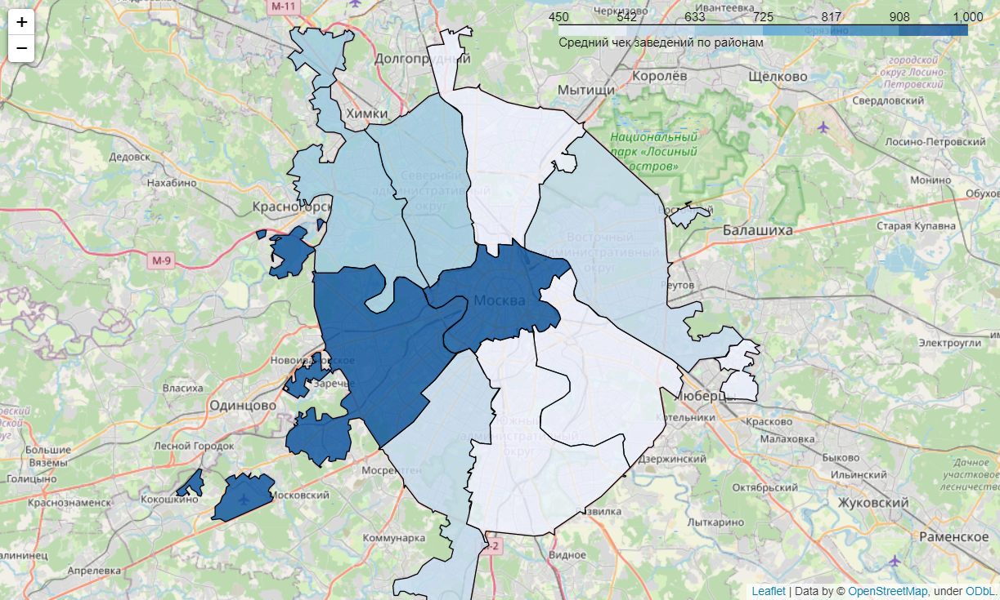

**Промежуточный вывод:**

Карта отразила наиболее высокий средний чек в Центральном и Западном административных районах, и наиболее низкий - в Северно-Восточном, Южном и Юго-Восточном округах.

Также рассмотрим цены в административных округах по отдельности. Сначала распределение среднего чека в целом:

In [64]:
fig = go.Figure()
for district in df['district'].unique():
    fig.add_trace(go.Violin(x = df[df['district'] == district]['district'],
                            y = df[df['district'] == district]['middle_avg_bill'],
                            name = district,
                            box_visible = True,
                            meanline_visible = True))

fig.update_layout(xaxis = {'categoryorder': 'median ascending'})    
fig.show()

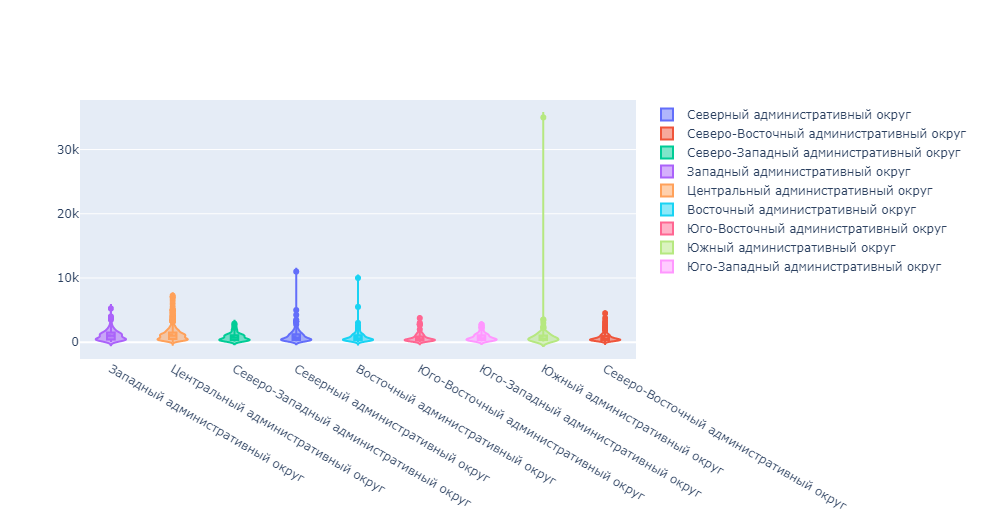

Затем с фильтрацией от возможных выбросов:

In [65]:
fig = go.Figure()
for district in df['district'].unique():
    fig.add_trace(go.Violin(x = df[(df['district'] == district) & (df['middle_avg_bill'] < 6000)]['district'],
                            y = df[(df['district'] == district)  & (df['middle_avg_bill'] < 6000)]['middle_avg_bill'],
                            name = district,
                            box_visible = True,
                            meanline_visible = True))
    
fig.update_layout(title = 'Распределение значений средних чеков', xaxis = {'categoryorder': 'median descending'})    
fig.show()

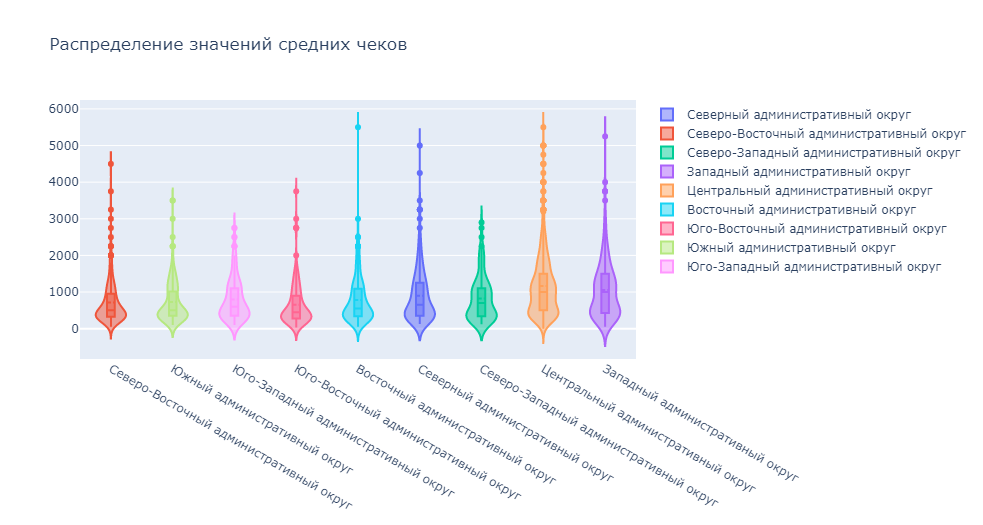

**Промежуточный вывод:**

- не для всех районов распределение среднего чека близко к нормальному;
- нижняя граница среднего чека выше всего для СЗАО;
- наименьший разброс среднего чека - в ЮЗАО.

### Вывод

В данной части исследования был проведён общий анализ данных. Ниже представлен общий вывод в соответствии с полученными результатами:

1. Наибольшее количество заведений - в категориях "кафе" и "ресторан" (более 2000 заведений и более 24% от общего количества), а наименьшее - в категориях "столовая" и "булочная" (менее 400 заведений и менее 4% от общего количества);
2. Среди заведений с количеством посадочных мест до 54 преобладают кофейни, а свыше 54 - рестораны. Наименьшие доли во всех категориях количества посадочных мест отводятся столовым и булочным. В категориях "кафе", "пиццерия", "быстрое питание" и "булочная" преобладают заведения до 35 посадочных мест. В ресторанах, кофейнях и столовых наибольшая доля заведений с количеством посадочных мест от 93 до 160 включительно. В барах и пабах чаще всего от 55 до 92 посадочных мест;
3. Несетевых заведений почти в 1,5 раза больше, чем сетевых (61,9% против 38,1%);
4. Наибольшее количество среди сетевых заведений составляют кафе, кофейни и рестораны. При этом в целом рестораны и кафе - чаще всего несетевые (64,3% против 35,7% для ресторанов и 67,2% против 32,8% для кафе). Почти в каждой категории превалируют несетевые заведения, за исключением кофеен, пиццерий и булочных;
5. В топ-15 сетевых заведений ожидаемо попали заведения "на слуху" - такие, как "Шоколадница", "Додо пицца", "Доминос пицца" и др. Наибольшее количество заведений из топ-15 находятся в Центральном районе, наименьшее же - в Северо-Западном административном округе. Наибольшую долю в топ-15 сетях составляет категория "кофейни" - это почти половина от общего количества заведений в топ-15, за ними следуют рестораны и пиццерии, совместно составляя около 40%. Наименьшее количество в топ-15 сетевых заведений составляют заведения быстрого питания, бары, пабы и столовые - в сумме менее 1% от общего количества заведений топа;
6. Наибольшее количество заведений в целом - в Центральном административном округе, наименьшее - в Северо-Западном. В Центральном округе также значительно больше абсолютное количество заведений каждой категории, за исключением категории "быстрое питание";
7. Средний рейтинг не сильно разнится в зависимости от категорий заведений, для каждой категории он выше 4 пунктов. Однако при этом самый высокий рейтинг - у баров и пабов (4,39), а самый низкий - у кафе и заведений быстрого питания (4,12 и 4,05 соответственно).
8. Самый высокий средний рейтинг - в Центральном административном округе (4,38), а самый низкий - в Юго-Восточном (4,1);
9. Наибольшее количество заведений среди топ-15 улиц - на проспекте Мира, а наименьшее - на Пятницкой улице. На проспекте Мира также большее абослютное количество ресторанов, кафе, кофеен и заведений быстрого питания, но по абсолютному количеству заведений других категорий проспект Мира проигрывает другим улицам;
10. Средний рейтинг для заведений, которые являются единственными на улице - немного выше, чем в целом по заведениям, за исключением ресторанов. Также среди единственных заведений на улице большее процентное соотношение заведений низкой и средней ценовой категории, чем для заведений в целом. Среди единственных заведений на улице доля несетевых заведений выше (71% против 61,9%). Среди единственных заведений на улице большее процентное соотношение заведений низкой и средней ценовой категории к остальным, чем для заведений в целом (более 71% против примерно 68%). Доля круглосуточных среди единственных заведений на улице больше, чем среди всех заведений (93,2% против 91,3%). Среди единственных заведений более 63% имеют до 54 посадочных мест, тогда как среди всех заведений - всего около 40% таких. При этом единственных на улице заведений с количеством посадочных мест более 160 - всего 5,13%, а в целом таких заведений почти в 4 раза больше - 19,4%;
11. Наиболее высокий средний чек в Центральном и Западном административных районах (1000 руб.), и наиболее низкий - в Северно-Восточном, Южном и Юго-Восточном округах (500, 500 и 450 руб. соответственно);
12. Не для всех районов распределение среднего чека близко к нормальному. Нижняя граница среднего чека выше всего для СЗАО; наименьший разброс среднего чека - в ЮЗАО.

## Детализация исследования: кофейни

### Анализ количества кофеен и их расположения

Проверим, какое количество кофеен представлено в датасете:

In [66]:
df[df['category'] == 'кофейня']['category'].count()

1413

Всего в таблице 1413 кофеен. Посмотрим их распределение по районам:

In [67]:
coffeehouse_by_district = df[df['category'] == 'кофейня'].groupby('district', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)

coffeehouse_by_district

,district,amount
5,Центральный административный округ,428
2,Северный административный округ,193
3,Северо-Восточный административный округ,159
1,Западный административный округ,150
8,Южный административный округ,131
0,Восточный административный округ,105
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


In [68]:
px.bar(coffeehouse_by_district.sort_values(by = 'amount'),
      x = 'amount',
      y = 'district',
      title = 'Количество кофеен в административных округах',
      labels = {'amount': 'Количество кофеен',
               'district': ''},
      text_auto = True)

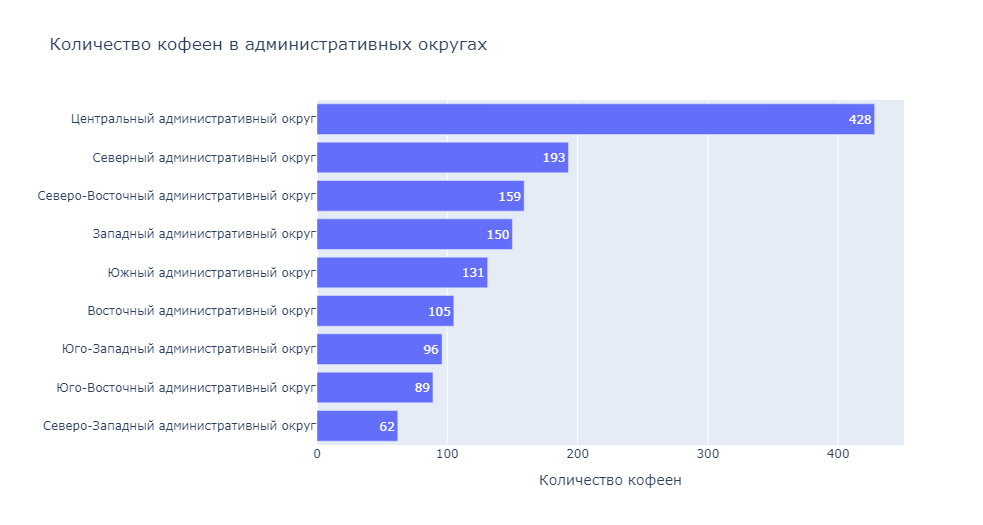

**Промежуточный вывод:**

Наибольшее количество кофеен (428) расположено в Центральном административном округе - в следующем за ним по количеству Северном административном округе кофеен более чем в 2 раза меньше.

Посмотрим, часто ли кофейни встречаются среди единственных заведений на улице:

In [69]:
single_coffehouses = single_on_street.groupby('category', as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})\
.sort_values(by = 'amount', ascending = False)

single_coffehouses

,category,amount
3,кафе,160
6,ресторан,93
4,кофейня,84
0,"бар,паб",39
7,столовая,36
2,быстрое питание,23
5,пиццерия,15
1,булочная,8


In [70]:
px.pie(single_coffehouses,
      names = 'category',
      values = 'amount',
      title = 'Распределение заведений по категориям среди единственных на улице')

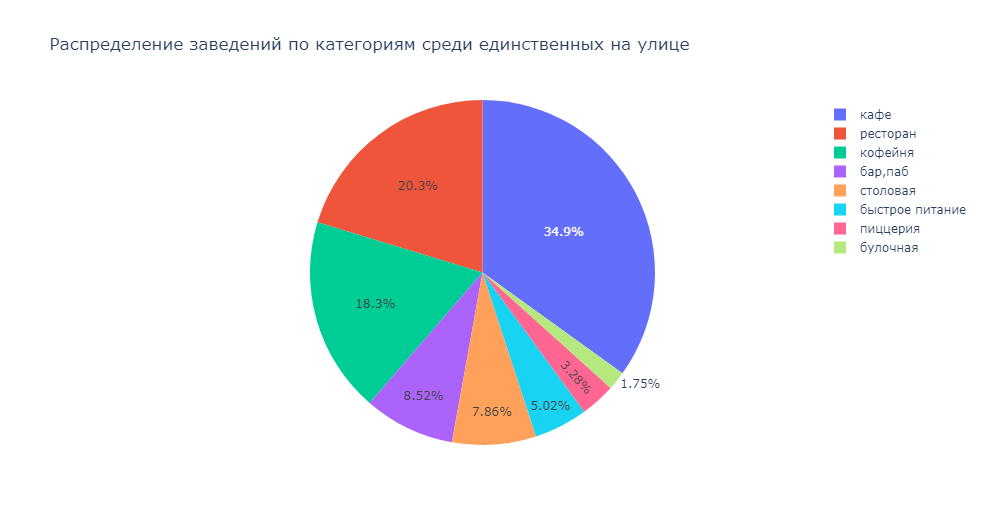

**Промежуточный вывод:**

Среди единственных заведений на улице кофейни занимают третье место по количеству и составляют 18,3% от общего числа таких заведений.

Также рассмотрим соотношение единственных кофеен на улице к общему числу кофеен в датасете:

In [71]:
coffeehouses = pd.DataFrame({'единственные': single_coffehouses[single_coffehouses['category'] == 'кофейня']['amount'],
                             'не единственные': df[df['category'] == 'кофейня']['category'].count()\
                             - single_coffehouses[single_coffehouses['category'] == 'кофейня']['amount'],
                            'всего': df[df['category'] == 'кофейня']['category'].count()}).T\
.reset_index()\
.rename(columns={4: 'amount',
                'index': 'type'})

coffeehouses['percent'] = round(coffeehouses['amount'] * 100 / df[df['category'] == 'кофейня']['category'].count(), 3)
coffeehouses

,type,amount,percent
0,единственные,84,5.945
1,не единственные,1329,94.055
2,всего,1413,100.000


In [72]:
px.pie(coffeehouses[coffeehouses['type'] != 'всего'],
      values = 'amount',
      names = 'type',
      title = 'Соотношение кофеен среди единственных и не единственных заведений на улице')

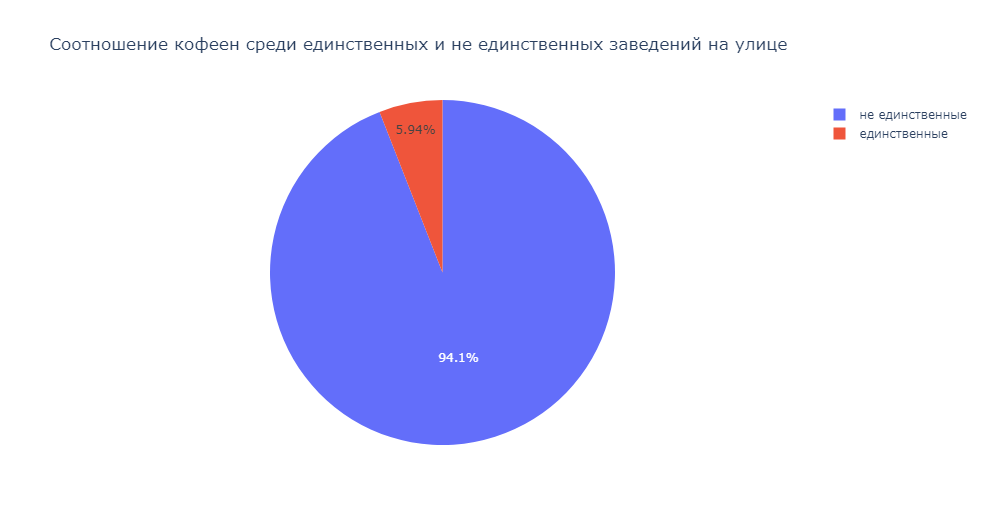

**Промежуточный вывод:**

В 94,1% случаев кофейни не являются единственным заведением на улице.

Проверим, сколько кофеен от общего количества кофеен являются единственными кофейнями на улице:

In [73]:
single_coffeehouses = df.groupby(['street', 'category'], as_index = False)\
.agg({'name': 'count'})\
.rename(columns = {'name': 'amount'})

single_coffeehouses[(single_coffeehouses['category'] == 'кофейня')
                    & (single_coffeehouses['amount'] == 1)]['amount'].count()

371

In [74]:
single_to_total = pd.DataFrame({'type': ['всего', 'единственные', 'не единственные'],
                               'amount': [1413, 371, 1413 - 371],
                               'percent': [100.000,
                                          round(371 * 100 / 1413, 3),
                                          round((1413 - 371) * 100 / 1413, 3)]})
single_to_total

,type,amount,percent
0,всего,1413,100.000
1,единственные,371,26.256
2,не единственные,1042,73.744


In [75]:
px.pie(single_to_total[single_to_total['type'] != 'всего'],
      values = 'amount',
      names = 'type',
      title = 'Распределение единственных и не единственных кофеен на улице')

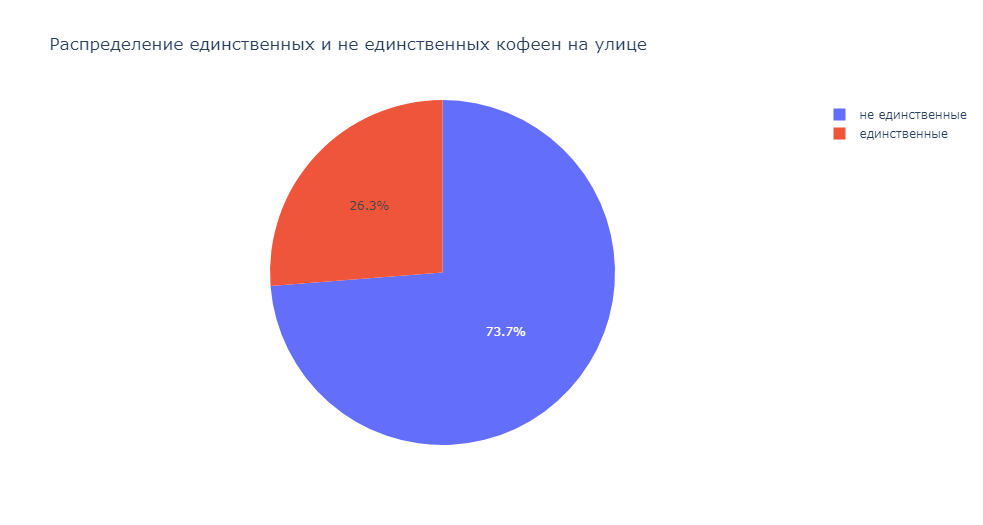

**Промежуточный вывод:**

Хотя соотношение единственных кофеен на улице к общему количеству невелико (чуть больше четверти), такие кофейни всё же встречаются на 20% чаще, чем кофейни, являющиеся единственным заведением на улице.

### Анализ круглосуточных кофеен

Посмотрим, есть ли в нашей таблице круглосуточные кофейни:

In [76]:
coffeehouses_all_day = df[(df['category'] == 'кофейня') & (df['is_24/7'] == True)]
coffeehouses_all_day['name'].count()

59

Всего в Москве 59 таких кофеен. Посмотрим, как они распределены по районам:

In [77]:
px.bar(coffeehouses_all_day.groupby('district', as_index = False)
       .agg({'name': 'count'})
       .rename(columns = {'name': 'amount'})
       .sort_values(by = 'amount', ascending = False),
       x = 'district',
      y = 'amount',
      title = 'Количество круглосуточных кофеен по административным округам',
      labels = {'district': 'Район',
               'amount': 'Количество кофеен'},
      text_auto = True,
      width = 900, 
       height = 600)

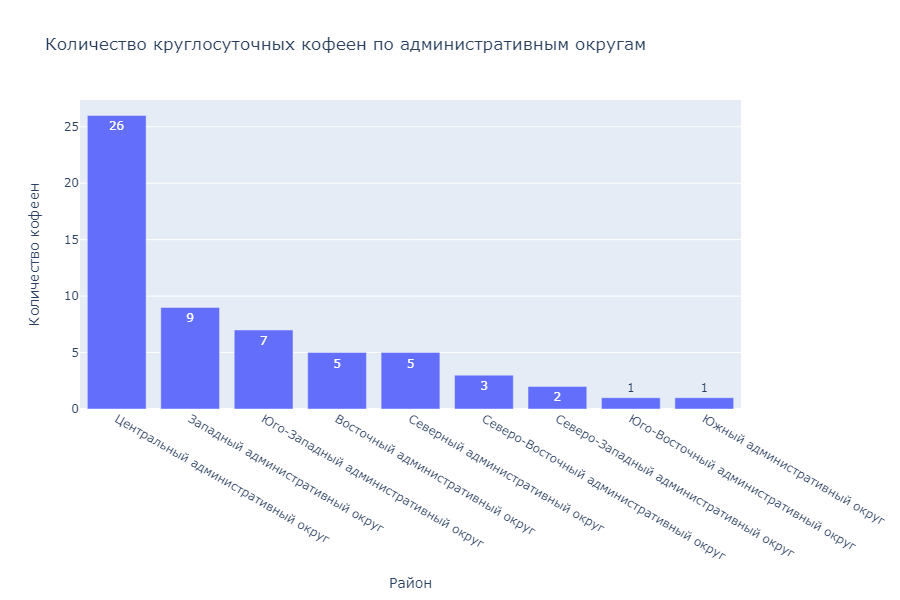

**Промежуточный вывод:**

26 из 59 круглосуточных кофеен расположены в ЦАО, в остальных же районах это почти единичные случаи.

Посмотрим на средний рейтинг круглосуточных кофеен и сравним его с рейтингом кофеен в целом:

In [78]:
# круглосуточные кофейни 
round(coffeehouses_all_day['rating'].mean(), 2)

4.21

In [79]:
# кофейни в целом
round(df[df['category'] == 'кофейня']['rating'].mean(), 2)

4.28

**Промежуточный вывод:**

Средний рейтинг круглосуточных кофеен ниже на 0,07 пункта, чем рейтинг кофеен в целом.

Рассмотрим распределение ценовых сегментов для круглосуточных кофеен:

In [80]:
px.pie(coffeehouses_all_day.groupby('price', as_index = False)
       .agg({'name': 'count'})
      .rename(columns = {'name': 'amount'}),
      values = 'amount',
      names = 'price',
      title = 'Распределение ценовых сегментов среди круглосуточных кофеен')

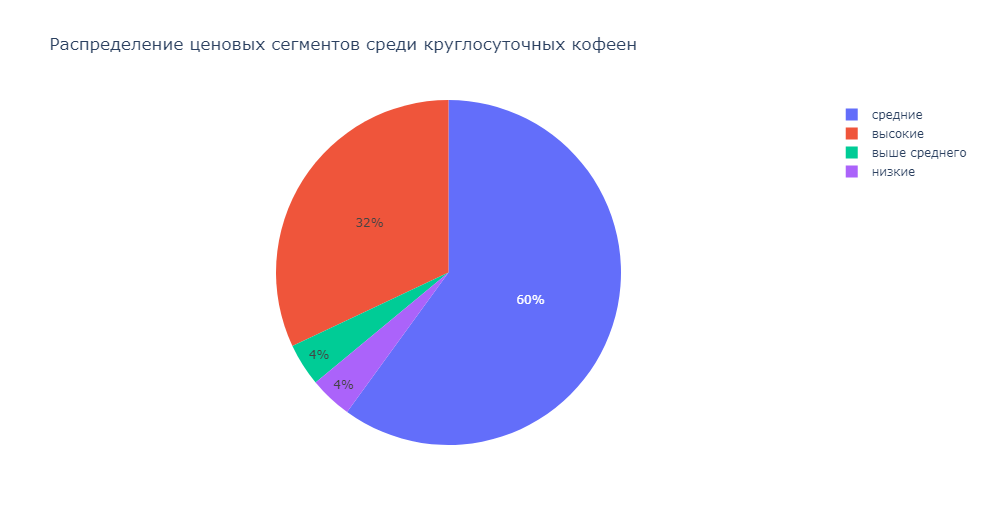

**Промежуточный вывод:**

Среди круглосуточных кофеен превалируют заведения среднего ценового сегмента, составляя 60% (среди тех, для которых есть данные о ценовом сегменте). Следом идут кофейни с высокими ценами (32%), а заведения сегментов низких цен и выше среднего в общей сложности составляют всего 8%.

Далее посмотрим на распределение круглосуточных кофеен по количеству посадочных мест:

In [81]:
px.pie(coffeehouses_all_day.groupby('seats_cat', as_index = False)
      .agg({'name': 'count'})
      .rename(columns = {'name': 'amount'}),
      names = 'seats_cat',
      values = 'amount',
      title = 'Распределение круглосуточных кофеен по количеству посадочных мест')

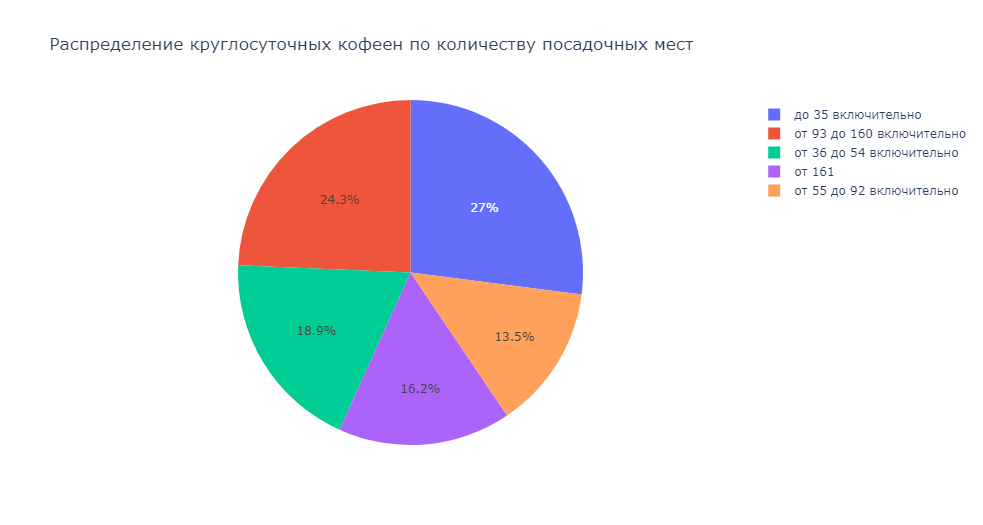

**Промежуточный вывод:**

Наибольшую долю круглосуточных кофеен составляют заведения с количеством посадочным мест до 35 (27%). Следом идут кофейни с 93-160 посадочными местами, их процент тоже высок - 24,3%.  

### Анализ рейтингов кофеен по районам

Рассчитаем средний рейтинг кофеен в разрезе административных округов:

In [82]:
coffehouses_avg_rating = df[df['category'] == 'кофейня'].groupby('district', as_index = False)\
.agg({'rating': 'mean'})\
.sort_values(by = 'rating', ascending = False)

coffehouses_avg_rating['rating'] = round(coffehouses_avg_rating['rating'], 2)
coffehouses_avg_rating

,district,rating
5,Центральный административный округ,4.34
4,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
7,Юго-Западный административный округ,4.28
0,Восточный административный округ,4.28
8,Южный административный округ,4.23
6,Юго-Восточный административный округ,4.23
3,Северо-Восточный административный округ,4.22
1,Западный административный округ,4.20


In [83]:
px.bar(coffehouses_avg_rating,
      x = 'district',
      y = 'rating',
      title = 'Рейтинг кофеен по округам',
      text_auto = True,
      labels = {'district': 'Район',
               'rating': 'Рейтинг'})\
.update_yaxes(range = list([4, 4.5]))

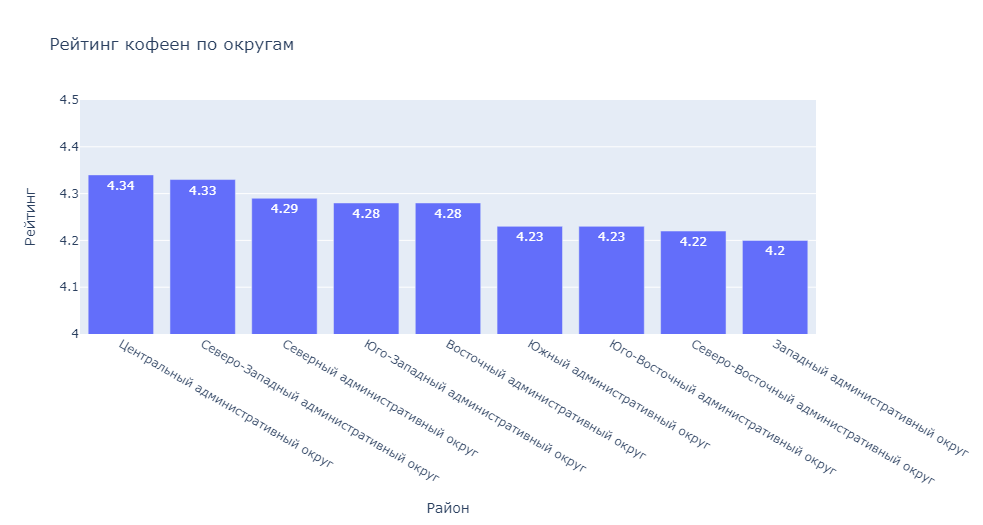

И нанесём его на карту:

In [84]:
moscow_map_coffeehouses = Map(location = [55.751244, 37.618423],
                              zoom_start=10)

Choropleth(geo_data = state_geo,
          data = coffehouses_avg_rating,
          columns = ['district', 'rating'],
          key_on = 'feature.name',
          fill_color = 'Blues',
          fill_opacity = 0.8,
          legend_name = 'Средний рейтинг кофеен по районам').add_to(moscow_map_coffeehouses)

moscow_map_coffeehouses

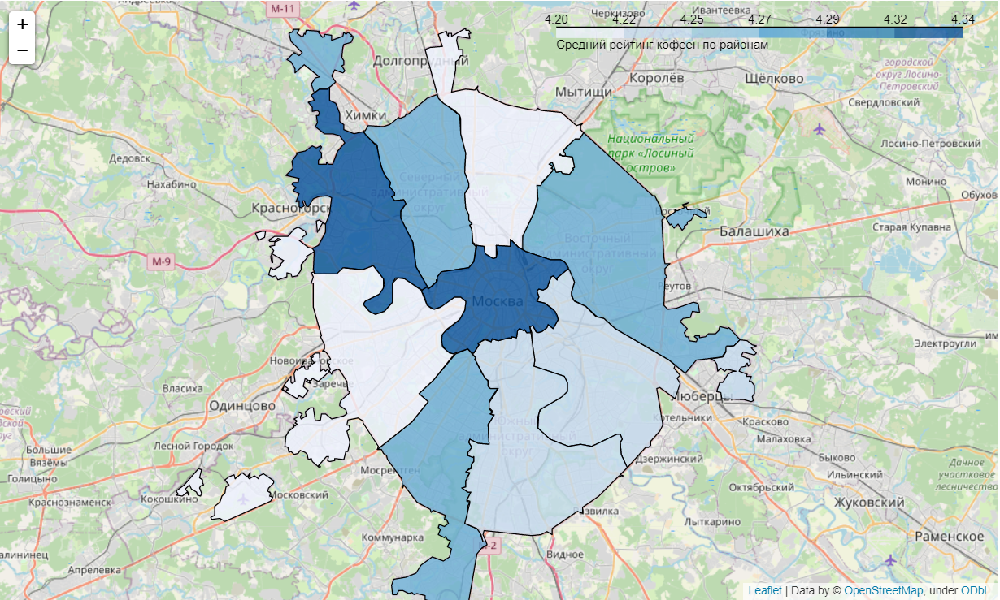

**Промежуточный вывод:**

Самый высокий средний рейтинг - у кофеен Центрального и Северо-Западного административных округов (4,34 и 4,33 соответственно), а самый низкий - в Северо-Восточном и Западном административных округах (4,22 и 4,2 соответственно).

### Анализ средней стоимости чашки кофе

Анализировать среднюю стоимость чашки кофе будем также в разрезе районов:

In [85]:
coffehouses_avg_cup = df[df['category'] == 'кофейня'].groupby('district', as_index = False)\
.agg({'middle_coffee_cup': 'median'})\
.sort_values(by = 'middle_coffee_cup', ascending = False)

coffehouses_avg_cup['middle_coffee_cup'] = round(coffehouses_avg_cup['middle_coffee_cup'], 2)
coffehouses_avg_cup

,district,middle_coffee_cup
7,Юго-Западный административный округ,198.0
5,Центральный административный округ,190.0
1,Западный административный округ,189.0
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
8,Южный административный округ,150.0
6,Юго-Восточный административный округ,147.5
0,Восточный административный округ,135.0


In [86]:
px.bar(coffehouses_avg_cup,
      x = 'district',
      y = 'middle_coffee_cup',
      text_auto = True,
      title = 'Средняя стоимость чашки кофе в кофейнях по административным округам',
      labels = {'district': 'Район',
               'middle_coffee_cup': 'Средняя стоимость чашки кофе'})

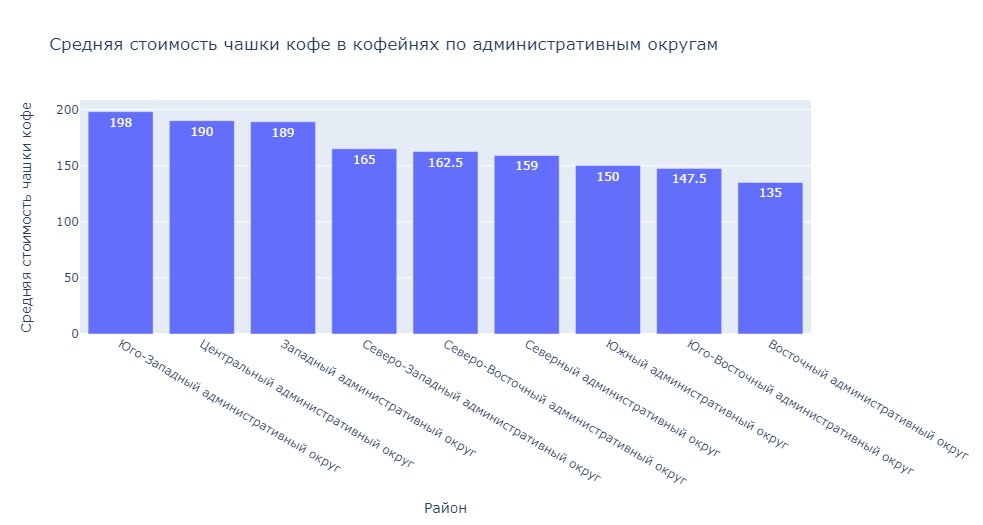

In [87]:
moscow_map_avg_cup = Map(location = [55.751244, 37.618423],
                         zoom_start=10)

Choropleth(geo_data = state_geo,
          data = coffehouses_avg_cup,
          columns = ['district', 'middle_coffee_cup'],
          key_on = 'feature.name',
          fill_color = 'Blues',
          fill_opacity = 0.8,
          legend_name = 'Средняя стоимость чашки кофе по районам').add_to(moscow_map_avg_cup)

moscow_map_avg_cup

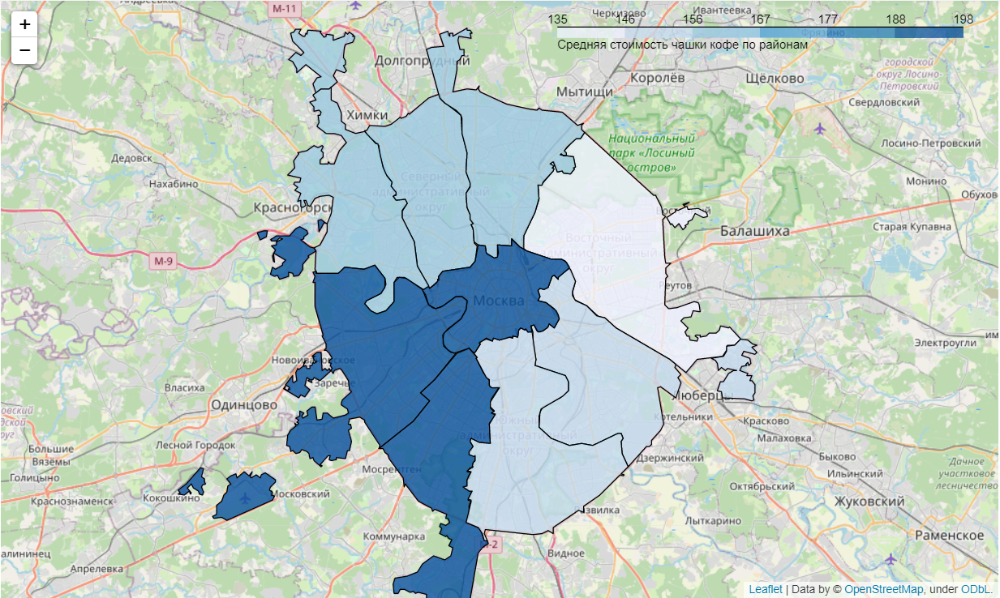

**Промежуточный вывод:**

Средняя стоимость чашки кофе выше в Юго-Западном, Центральном и Западном административных округах (198, 190 и 189 руб. соответственно), а самая низкая - в Восточном административном округе (135 руб).

### Рекомендации по открытию кофейни

1. С точки зрения наименьшей конкуренции (по количеству заведений такого же формата) лучшие районы для открытия - Юго-Западный, Юго-Восточный и Северо-Западный. Удачно, если кофейня окажется единственным заведением на улице или хотя бы единственной кофейней;
2. Для открытия круглосуточной кофейни лучше всего подходят Северо-Западный, Юго-Восточный и Южный округи - в них всего по 1-2 круглосуточных кофейни;
3. Средняя стоимость чашки кофе выше в Юго-Западном, Центральном и Западном административных округах, а значит, в этих АО можно открывать кофейню не самого низкого ценового сегмента, или же, наоборот, демпинговать.

По совокупности факторов, перечисленных выше, наиболее удачный район для открытия - Юго-Западный. Ниже несколько фактов о нём:
- общее количество заведений в ЮЗАО - одно из наименьших;
- рейтинг заведений в целом в ЮЗАО также один из наиболее низких, что может при определённых обстоятельствах повысить конкурентоспособность нового заведения, средний рейтинг кофеен - средний, не в числе высоких;
- средний чек в целом для заведений - средний, но при этом средняя стоимость чашки кофе в кофейнях - наиболее высокая;
- по количеству кофеен ЮЗАО занимает одно из последних мест, а это означает меньшую конкуренцию;
- в ЮЗАО всего 7 круглосуточных кофеен, поэтому формат часов работы нового заведения может быть в том числе и круглосуточным - конкуренция в ночные часы невелика.